# Session (475165_f5_stage2_day6)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f5_stage2_day6" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f5"
day = "day6"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35015, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


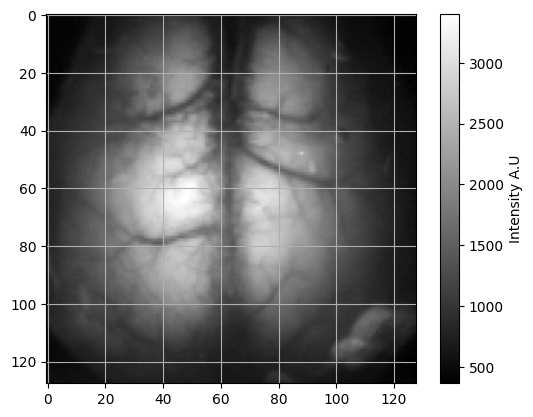

frame number 6000 plotted


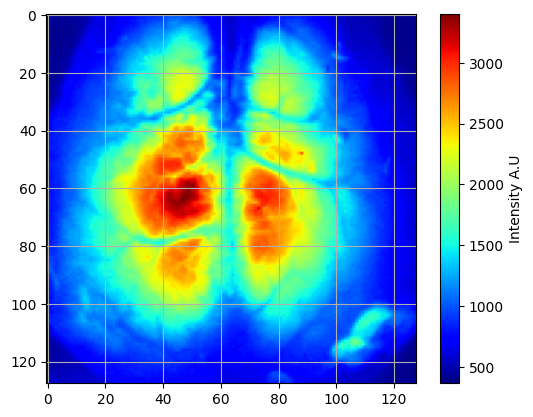

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 397.336962890625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 447.00408325195315


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 96
Number of double_flash pairs: 48
Number of single_flash: 46
Number of total flashes: 142


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/142 [00:00<?, ?it/s]

  1%|▌                                                                                 | 1/142 [00:01<03:16,  1.39s/it]

  1%|█▏                                                                                | 2/142 [00:02<03:10,  1.36s/it]

  2%|█▋                                                                                | 3/142 [00:04<03:08,  1.35s/it]

  3%|██▎                                                                               | 4/142 [00:05<02:55,  1.27s/it]

  4%|██▉                                                                               | 5/142 [00:06<02:58,  1.31s/it]

  4%|███▍                                                                              | 6/142 [00:08<03:02,  1.34s/it]

  5%|████                                                                              | 7/142 [00:09<02:55,  1.30s/it]

  6%|████▌                                                                             | 8/142 [00:10<02:58,  1.33s/it]

  6%|█████▏                                                                            | 9/142 [00:11<02:55,  1.32s/it]

  7%|█████▋                                                                           | 10/142 [00:13<02:57,  1.34s/it]

  8%|██████▎                                                                          | 11/142 [00:14<02:56,  1.35s/it]

  8%|██████▊                                                                          | 12/142 [00:16<02:55,  1.35s/it]

  9%|███████▍                                                                         | 13/142 [00:17<02:51,  1.33s/it]

 10%|███████▉                                                                         | 14/142 [00:18<02:52,  1.35s/it]

 11%|████████▌                                                                        | 15/142 [00:19<02:48,  1.33s/it]

 11%|█████████▏                                                                       | 16/142 [00:21<02:53,  1.38s/it]

 12%|█████████▋                                                                       | 17/142 [00:22<02:51,  1.37s/it]

 13%|██████████▎                                                                      | 18/142 [00:24<02:51,  1.38s/it]

 13%|██████████▊                                                                      | 19/142 [00:25<02:46,  1.35s/it]

 14%|███████████▍                                                                     | 20/142 [00:26<02:43,  1.34s/it]

 15%|███████████▉                                                                     | 21/142 [00:28<02:38,  1.31s/it]

 15%|████████████▌                                                                    | 22/142 [00:29<02:34,  1.29s/it]

 16%|█████████████                                                                    | 23/142 [00:30<02:37,  1.33s/it]

 17%|█████████████▋                                                                   | 24/142 [00:32<02:37,  1.33s/it]

 18%|██████████████▎                                                                  | 25/142 [00:33<02:36,  1.34s/it]

 18%|██████████████▊                                                                  | 26/142 [00:34<02:35,  1.34s/it]

 19%|███████████████▍                                                                 | 27/142 [00:36<02:31,  1.31s/it]

 20%|███████████████▉                                                                 | 28/142 [00:37<02:27,  1.30s/it]

 20%|████████████████▌                                                                | 29/142 [00:38<02:25,  1.29s/it]

 21%|█████████████████                                                                | 30/142 [00:39<02:25,  1.30s/it]

 22%|█████████████████▋                                                               | 31/142 [00:41<02:26,  1.32s/it]

 23%|██████████████████▎                                                              | 32/142 [00:42<02:22,  1.29s/it]

 23%|██████████████████▊                                                              | 33/142 [00:43<02:22,  1.31s/it]

 24%|███████████████████▍                                                             | 34/142 [00:45<02:23,  1.33s/it]

 25%|███████████████████▉                                                             | 35/142 [00:46<02:22,  1.33s/it]

 25%|████████████████████▌                                                            | 36/142 [00:47<02:21,  1.34s/it]

 26%|█████████████████████                                                            | 37/142 [00:49<02:21,  1.35s/it]

 27%|█████████████████████▋                                                           | 38/142 [00:50<02:18,  1.33s/it]

 27%|██████████████████████▏                                                          | 39/142 [00:51<02:18,  1.34s/it]

 28%|██████████████████████▊                                                          | 40/142 [00:53<02:14,  1.32s/it]

 29%|███████████████████████▍                                                         | 41/142 [00:54<02:10,  1.29s/it]

 30%|███████████████████████▉                                                         | 42/142 [00:55<02:08,  1.28s/it]

 30%|████████████████████████▌                                                        | 43/142 [00:56<02:04,  1.26s/it]

 31%|█████████████████████████                                                        | 44/142 [00:58<02:02,  1.25s/it]

 32%|█████████████████████████▋                                                       | 45/142 [00:59<02:01,  1.26s/it]

 32%|██████████████████████████▏                                                      | 46/142 [01:00<02:00,  1.25s/it]

 33%|██████████████████████████▊                                                      | 47/142 [01:01<01:59,  1.26s/it]

 34%|███████████████████████████▍                                                     | 48/142 [01:03<02:04,  1.32s/it]

 35%|███████████████████████████▉                                                     | 49/142 [01:04<02:02,  1.32s/it]

 35%|████████████████████████████▌                                                    | 50/142 [01:05<01:58,  1.29s/it]

 36%|█████████████████████████████                                                    | 51/142 [01:07<02:00,  1.32s/it]

 37%|█████████████████████████████▋                                                   | 52/142 [01:08<02:01,  1.35s/it]

 37%|██████████████████████████████▏                                                  | 53/142 [01:10<02:00,  1.36s/it]

 38%|██████████████████████████████▊                                                  | 54/142 [01:11<01:59,  1.36s/it]

 39%|███████████████████████████████▎                                                 | 55/142 [01:12<01:56,  1.34s/it]

 39%|███████████████████████████████▉                                                 | 56/142 [01:14<01:56,  1.36s/it]

 40%|████████████████████████████████▌                                                | 57/142 [01:15<01:53,  1.34s/it]

 41%|█████████████████████████████████                                                | 58/142 [01:16<01:53,  1.35s/it]

 42%|█████████████████████████████████▋                                               | 59/142 [01:18<01:50,  1.34s/it]

 42%|██████████████████████████████████▏                                              | 60/142 [01:19<01:52,  1.37s/it]

 43%|██████████████████████████████████▊                                              | 61/142 [01:20<01:51,  1.38s/it]

 44%|███████████████████████████████████▎                                             | 62/142 [01:22<01:47,  1.34s/it]

 44%|███████████████████████████████████▉                                             | 63/142 [01:23<01:43,  1.31s/it]

 45%|████████████████████████████████████▌                                            | 64/142 [01:24<01:43,  1.33s/it]

 46%|█████████████████████████████████████                                            | 65/142 [01:26<01:40,  1.31s/it]

 46%|█████████████████████████████████████▋                                           | 66/142 [01:27<01:39,  1.31s/it]

 47%|██████████████████████████████████████▏                                          | 67/142 [01:28<01:38,  1.31s/it]

 48%|██████████████████████████████████████▊                                          | 68/142 [01:29<01:36,  1.30s/it]

 49%|███████████████████████████████████████▎                                         | 69/142 [01:31<01:36,  1.32s/it]

 49%|███████████████████████████████████████▉                                         | 70/142 [01:32<01:34,  1.31s/it]

 50%|████████████████████████████████████████▌                                        | 71/142 [01:33<01:33,  1.32s/it]

 51%|█████████████████████████████████████████                                        | 72/142 [01:35<01:31,  1.31s/it]

 51%|█████████████████████████████████████████▋                                       | 73/142 [01:36<01:34,  1.37s/it]

 52%|██████████████████████████████████████████▏                                      | 74/142 [01:38<01:33,  1.38s/it]

 53%|██████████████████████████████████████████▊                                      | 75/142 [01:39<01:28,  1.32s/it]

 54%|███████████████████████████████████████████▎                                     | 76/142 [01:40<01:27,  1.32s/it]

 54%|███████████████████████████████████████████▉                                     | 77/142 [01:42<01:28,  1.36s/it]

 55%|████████████████████████████████████████████▍                                    | 78/142 [01:43<01:26,  1.36s/it]

 56%|█████████████████████████████████████████████                                    | 79/142 [01:44<01:25,  1.35s/it]

 56%|█████████████████████████████████████████████▋                                   | 80/142 [01:46<01:21,  1.32s/it]

 57%|██████████████████████████████████████████████▏                                  | 81/142 [01:47<01:20,  1.32s/it]

 58%|██████████████████████████████████████████████▊                                  | 82/142 [01:48<01:18,  1.31s/it]

 58%|███████████████████████████████████████████████▎                                 | 83/142 [01:50<01:18,  1.34s/it]

 59%|███████████████████████████████████████████████▉                                 | 84/142 [01:51<01:18,  1.35s/it]

 60%|████████████████████████████████████████████████▍                                | 85/142 [01:52<01:16,  1.35s/it]

 61%|█████████████████████████████████████████████████                                | 86/142 [01:54<01:14,  1.33s/it]

 61%|█████████████████████████████████████████████████▋                               | 87/142 [01:55<01:13,  1.34s/it]

 62%|██████████████████████████████████████████████████▏                              | 88/142 [01:56<01:13,  1.36s/it]

 63%|██████████████████████████████████████████████████▊                              | 89/142 [01:58<01:14,  1.40s/it]

 63%|███████████████████████████████████████████████████▎                             | 90/142 [01:59<01:11,  1.37s/it]

 64%|███████████████████████████████████████████████████▉                             | 91/142 [02:00<01:09,  1.36s/it]

 65%|████████████████████████████████████████████████████▍                            | 92/142 [02:02<01:08,  1.36s/it]

 65%|█████████████████████████████████████████████████████                            | 93/142 [02:03<01:06,  1.36s/it]

 66%|█████████████████████████████████████████████████████▌                           | 94/142 [02:04<01:03,  1.32s/it]

 67%|██████████████████████████████████████████████████████▏                          | 95/142 [02:06<01:03,  1.35s/it]

 68%|██████████████████████████████████████████████████████▊                          | 96/142 [02:07<01:01,  1.35s/it]

 68%|███████████████████████████████████████████████████████▎                         | 97/142 [02:08<00:59,  1.33s/it]

 69%|███████████████████████████████████████████████████████▉                         | 98/142 [02:10<00:57,  1.30s/it]

 70%|████████████████████████████████████████████████████████▍                        | 99/142 [02:11<00:55,  1.28s/it]

 70%|████████████████████████████████████████████████████████▎                       | 100/142 [02:12<00:54,  1.29s/it]

 71%|████████████████████████████████████████████████████████▉                       | 101/142 [02:14<00:53,  1.29s/it]

 72%|█████████████████████████████████████████████████████████▍                      | 102/142 [02:15<00:51,  1.30s/it]

 73%|██████████████████████████████████████████████████████████                      | 103/142 [02:16<00:50,  1.30s/it]

 73%|██████████████████████████████████████████████████████████▌                     | 104/142 [02:18<00:51,  1.35s/it]

 74%|███████████████████████████████████████████████████████████▏                    | 105/142 [02:19<00:49,  1.34s/it]

 75%|███████████████████████████████████████████████████████████▋                    | 106/142 [02:20<00:47,  1.32s/it]

 75%|████████████████████████████████████████████████████████████▎                   | 107/142 [02:22<00:47,  1.36s/it]

 76%|████████████████████████████████████████████████████████████▊                   | 108/142 [02:23<00:45,  1.35s/it]

 77%|█████████████████████████████████████████████████████████████▍                  | 109/142 [02:24<00:44,  1.33s/it]

 77%|█████████████████████████████████████████████████████████████▉                  | 110/142 [02:26<00:42,  1.32s/it]

 78%|██████████████████████████████████████████████████████████████▌                 | 111/142 [02:27<00:41,  1.32s/it]

 79%|███████████████████████████████████████████████████████████████                 | 112/142 [02:28<00:39,  1.30s/it]

 80%|███████████████████████████████████████████████████████████████▋                | 113/142 [02:29<00:36,  1.26s/it]

 80%|████████████████████████████████████████████████████████████████▏               | 114/142 [02:31<00:37,  1.32s/it]

 81%|████████████████████████████████████████████████████████████████▊               | 115/142 [02:32<00:35,  1.30s/it]

 82%|█████████████████████████████████████████████████████████████████▎              | 116/142 [02:33<00:33,  1.27s/it]

 82%|█████████████████████████████████████████████████████████████████▉              | 117/142 [02:35<00:31,  1.28s/it]

 83%|██████████████████████████████████████████████████████████████████▍             | 118/142 [02:36<00:31,  1.30s/it]

 84%|███████████████████████████████████████████████████████████████████             | 119/142 [02:37<00:30,  1.32s/it]

 85%|███████████████████████████████████████████████████████████████████▌            | 120/142 [02:39<00:29,  1.35s/it]

 85%|████████████████████████████████████████████████████████████████████▏           | 121/142 [02:40<00:28,  1.34s/it]

 86%|████████████████████████████████████████████████████████████████████▋           | 122/142 [02:41<00:26,  1.33s/it]

 87%|█████████████████████████████████████████████████████████████████████▎          | 123/142 [02:43<00:24,  1.31s/it]

 87%|█████████████████████████████████████████████████████████████████████▊          | 124/142 [02:44<00:24,  1.35s/it]

 88%|██████████████████████████████████████████████████████████████████████▍         | 125/142 [02:45<00:23,  1.37s/it]

 89%|██████████████████████████████████████████████████████████████████████▉         | 126/142 [02:47<00:21,  1.35s/it]

 89%|███████████████████████████████████████████████████████████████████████▌        | 127/142 [02:48<00:19,  1.33s/it]

 90%|████████████████████████████████████████████████████████████████████████        | 128/142 [02:49<00:18,  1.34s/it]

 91%|████████████████████████████████████████████████████████████████████████▋       | 129/142 [02:51<00:17,  1.35s/it]

 92%|█████████████████████████████████████████████████████████████████████████▏      | 130/142 [02:52<00:15,  1.32s/it]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 131/142 [02:53<00:14,  1.31s/it]

 93%|██████████████████████████████████████████████████████████████████████████▎     | 132/142 [02:54<00:12,  1.28s/it]

 94%|██████████████████████████████████████████████████████████████████████████▉     | 133/142 [02:56<00:11,  1.29s/it]

 94%|███████████████████████████████████████████████████████████████████████████▍    | 134/142 [02:57<00:10,  1.29s/it]

 95%|████████████████████████████████████████████████████████████████████████████    | 135/142 [02:58<00:09,  1.29s/it]

 96%|████████████████████████████████████████████████████████████████████████████▌   | 136/142 [03:00<00:07,  1.26s/it]

 96%|█████████████████████████████████████████████████████████████████████████████▏  | 137/142 [03:01<00:06,  1.27s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 138/142 [03:02<00:05,  1.32s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▎ | 139/142 [03:04<00:03,  1.30s/it]

 99%|██████████████████████████████████████████████████████████████████████████████▊ | 140/142 [03:05<00:02,  1.33s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 141/142 [03:06<00:01,  1.30s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 142/142 [03:07<00:00,  1.29s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 142/142 [03:07<00:00,  1.32s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 20%|███████████████▋                                                                | 25/128 [00:00<00:00, 247.61it/s]

 39%|███████████████████████████████▎                                                | 50/128 [00:00<00:00, 247.61it/s]

 59%|██████████████████████████████████████████████▉                                 | 75/128 [00:00<00:00, 229.93it/s]

 77%|█████████████████████████████████████████████████████████████▉                  | 99/128 [00:00<00:00, 231.25it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 247.35it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 242.56it/s]

  0%|                                                                                        | 0/34562 [00:00<?, ?it/s]

  0%|                                                                              | 29/34562 [00:00<01:59, 289.47it/s]

  0%|▏                                                                             | 58/34562 [00:00<02:15, 255.32it/s]

  0%|▏                                                                             | 85/34562 [00:00<02:12, 259.40it/s]

  0%|▎                                                                            | 115/34562 [00:00<02:06, 271.63it/s]

  0%|▎                                                                            | 143/34562 [00:00<02:05, 273.62it/s]

  0%|▍                                                                            | 171/34562 [00:00<02:06, 272.16it/s]

  1%|▍                                                                            | 199/34562 [00:00<02:09, 264.59it/s]

  1%|▌                                                                            | 230/34562 [00:00<02:04, 275.92it/s]

  1%|▌                                                                            | 258/34562 [00:00<02:07, 268.29it/s]

  1%|▋                                                                            | 287/34562 [00:01<02:05, 273.10it/s]

  1%|▋                                                                            | 315/34562 [00:01<02:04, 274.35it/s]

  1%|▊                                                                            | 345/34562 [00:01<02:02, 279.45it/s]

  1%|▊                                                                            | 374/34562 [00:01<02:02, 280.14it/s]

  1%|▉                                                                            | 403/34562 [00:01<02:03, 276.55it/s]

  1%|▉                                                                            | 431/34562 [00:01<02:03, 275.98it/s]

  1%|█                                                                            | 459/34562 [00:01<02:03, 275.57it/s]

  1%|█                                                                            | 487/34562 [00:01<02:05, 272.10it/s]

  1%|█▏                                                                           | 515/34562 [00:01<02:04, 273.64it/s]

  2%|█▏                                                                           | 545/34562 [00:01<02:01, 278.95it/s]

  2%|█▎                                                                           | 574/34562 [00:02<02:01, 279.76it/s]

  2%|█▎                                                                           | 602/34562 [00:02<02:03, 275.81it/s]

  2%|█▍                                                                           | 632/34562 [00:02<02:00, 282.09it/s]

  2%|█▍                                                                           | 661/34562 [00:02<02:00, 281.96it/s]

  2%|█▌                                                                           | 690/34562 [00:02<01:59, 284.02it/s]

  2%|█▌                                                                           | 720/34562 [00:02<01:57, 288.21it/s]

  2%|█▋                                                                           | 749/34562 [00:02<02:03, 274.45it/s]

  2%|█▋                                                                           | 777/34562 [00:02<02:02, 275.89it/s]

  2%|█▊                                                                           | 805/34562 [00:02<02:02, 275.51it/s]

  2%|█▊                                                                           | 834/34562 [00:03<02:00, 278.96it/s]

  2%|█▉                                                                           | 862/34562 [00:03<02:02, 276.05it/s]

  3%|█▉                                                                           | 890/34562 [00:03<02:06, 267.05it/s]

  3%|██                                                                           | 917/34562 [00:03<02:17, 244.71it/s]

  3%|██                                                                           | 944/34562 [00:03<02:14, 249.59it/s]

  3%|██▏                                                                          | 975/34562 [00:03<02:06, 264.98it/s]

  3%|██▏                                                                         | 1005/34562 [00:03<02:03, 271.10it/s]

  3%|██▎                                                                         | 1033/34562 [00:03<02:03, 270.58it/s]

  3%|██▎                                                                         | 1064/34562 [00:03<02:00, 278.73it/s]

  3%|██▍                                                                         | 1092/34562 [00:04<02:04, 269.78it/s]

  3%|██▍                                                                         | 1120/34562 [00:04<02:04, 269.64it/s]

  3%|██▌                                                                         | 1149/34562 [00:04<02:01, 274.73it/s]

  3%|██▌                                                                         | 1177/34562 [00:04<02:04, 267.74it/s]

  3%|██▋                                                                         | 1205/34562 [00:04<02:03, 270.50it/s]

  4%|██▋                                                                         | 1233/34562 [00:04<02:03, 270.15it/s]

  4%|██▊                                                                         | 1261/34562 [00:04<02:05, 265.33it/s]

  4%|██▊                                                                         | 1289/34562 [00:04<02:03, 268.80it/s]

  4%|██▉                                                                         | 1316/34562 [00:04<02:13, 248.26it/s]

  4%|██▉                                                                         | 1342/34562 [00:04<02:23, 231.66it/s]

  4%|███                                                                         | 1369/34562 [00:05<02:18, 240.00it/s]

  4%|███                                                                         | 1394/34562 [00:05<02:17, 242.10it/s]

  4%|███                                                                         | 1419/34562 [00:05<02:20, 235.73it/s]

  4%|███▏                                                                        | 1443/34562 [00:05<02:21, 234.33it/s]

  4%|███▏                                                                        | 1470/34562 [00:05<02:16, 242.39it/s]

  4%|███▎                                                                        | 1496/34562 [00:05<02:14, 246.04it/s]

  4%|███▎                                                                        | 1522/34562 [00:05<02:14, 245.84it/s]

  4%|███▍                                                                        | 1549/34562 [00:05<02:11, 252.01it/s]

  5%|███▍                                                                        | 1579/34562 [00:05<02:04, 264.47it/s]

  5%|███▌                                                                        | 1609/34562 [00:06<02:01, 271.72it/s]

  5%|███▌                                                                        | 1639/34562 [00:06<01:58, 278.39it/s]

  5%|███▋                                                                        | 1668/34562 [00:06<01:57, 279.37it/s]

  5%|███▋                                                                        | 1698/34562 [00:06<01:56, 282.14it/s]

  5%|███▊                                                                        | 1727/34562 [00:06<02:08, 254.63it/s]

  5%|███▊                                                                        | 1753/34562 [00:06<02:10, 251.99it/s]

  5%|███▉                                                                        | 1781/34562 [00:06<02:07, 257.64it/s]

  5%|███▉                                                                        | 1809/34562 [00:06<02:06, 259.58it/s]

  5%|████                                                                        | 1839/34562 [00:06<02:02, 268.03it/s]

  5%|████                                                                        | 1866/34562 [00:07<02:02, 266.33it/s]

  5%|████▏                                                                       | 1893/34562 [00:07<02:10, 250.78it/s]

  6%|████▏                                                                       | 1919/34562 [00:07<02:10, 249.89it/s]

  6%|████▎                                                                       | 1946/34562 [00:07<02:08, 253.44it/s]

  6%|████▎                                                                       | 1972/34562 [00:07<02:07, 254.61it/s]

  6%|████▍                                                                       | 1998/34562 [00:07<02:12, 245.55it/s]

  6%|████▍                                                                       | 2023/34562 [00:07<02:13, 244.07it/s]

  6%|████▌                                                                       | 2048/34562 [00:07<02:15, 239.62it/s]

  6%|████▌                                                                       | 2074/34562 [00:07<02:13, 243.37it/s]

  6%|████▌                                                                       | 2099/34562 [00:07<02:23, 225.82it/s]

  6%|████▋                                                                       | 2125/34562 [00:08<02:18, 234.58it/s]

  6%|████▋                                                                       | 2151/34562 [00:08<02:15, 239.73it/s]

  6%|████▊                                                                       | 2179/34562 [00:08<02:10, 249.09it/s]

  6%|████▊                                                                       | 2207/34562 [00:08<02:06, 256.53it/s]

  6%|████▉                                                                       | 2235/34562 [00:08<02:03, 261.84it/s]

  7%|████▉                                                                       | 2263/34562 [00:08<02:01, 266.39it/s]

  7%|█████                                                                       | 2291/34562 [00:08<01:59, 270.20it/s]

  7%|█████                                                                       | 2320/34562 [00:08<01:59, 270.58it/s]

  7%|█████▏                                                                      | 2348/34562 [00:08<01:58, 270.98it/s]

  7%|█████▏                                                                      | 2378/34562 [00:09<01:56, 277.08it/s]

  7%|█████▎                                                                      | 2406/34562 [00:09<02:01, 265.51it/s]

  7%|█████▎                                                                      | 2433/34562 [00:09<02:05, 255.85it/s]

  7%|█████▍                                                                      | 2459/34562 [00:09<02:10, 245.97it/s]

  7%|█████▍                                                                      | 2488/34562 [00:09<02:05, 256.09it/s]

  7%|█████▌                                                                      | 2515/34562 [00:09<02:03, 259.31it/s]

  7%|█████▌                                                                      | 2542/34562 [00:09<02:12, 241.61it/s]

  7%|█████▋                                                                      | 2570/34562 [00:09<02:08, 248.08it/s]

  8%|█████▋                                                                      | 2598/34562 [00:09<02:04, 256.26it/s]

  8%|█████▊                                                                      | 2628/34562 [00:10<01:59, 266.43it/s]

  8%|█████▊                                                                      | 2658/34562 [00:10<01:56, 273.73it/s]

  8%|█████▉                                                                      | 2686/34562 [00:10<02:10, 244.50it/s]

  8%|█████▉                                                                      | 2716/34562 [00:10<02:03, 257.33it/s]

  8%|██████                                                                      | 2746/34562 [00:10<01:59, 266.90it/s]

  8%|██████                                                                      | 2774/34562 [00:10<01:59, 266.86it/s]

  8%|██████▏                                                                     | 2804/34562 [00:10<01:55, 273.95it/s]

  8%|██████▏                                                                     | 2832/34562 [00:10<01:56, 272.58it/s]

  8%|██████▎                                                                     | 2860/34562 [00:10<02:04, 255.61it/s]

  8%|██████▎                                                                     | 2890/34562 [00:11<01:59, 265.72it/s]

  8%|██████▍                                                                     | 2917/34562 [00:11<02:13, 236.92it/s]

  9%|██████▍                                                                     | 2947/34562 [00:11<02:06, 250.90it/s]

  9%|██████▌                                                                     | 2976/34562 [00:11<02:01, 260.12it/s]

  9%|██████▌                                                                     | 3006/34562 [00:11<01:57, 268.99it/s]

  9%|██████▋                                                                     | 3034/34562 [00:11<01:58, 266.85it/s]

  9%|██████▋                                                                     | 3061/34562 [00:11<02:02, 256.84it/s]

  9%|██████▊                                                                     | 3087/34562 [00:11<02:03, 255.61it/s]

  9%|██████▊                                                                     | 3113/34562 [00:11<02:05, 251.18it/s]

  9%|██████▉                                                                     | 3139/34562 [00:12<02:09, 242.68it/s]

  9%|██████▉                                                                     | 3164/34562 [00:12<02:10, 240.71it/s]

  9%|███████                                                                     | 3189/34562 [00:12<02:13, 234.75it/s]

  9%|███████                                                                     | 3214/34562 [00:12<02:12, 237.05it/s]

  9%|███████                                                                     | 3238/34562 [00:12<02:25, 215.29it/s]

  9%|███████▏                                                                    | 3261/34562 [00:12<02:23, 218.68it/s]

 10%|███████▏                                                                    | 3286/34562 [00:12<02:18, 225.49it/s]

 10%|███████▎                                                                    | 3314/34562 [00:12<02:10, 238.85it/s]

 10%|███████▎                                                                    | 3339/34562 [00:12<02:14, 232.76it/s]

 10%|███████▍                                                                    | 3363/34562 [00:12<02:13, 233.51it/s]

 10%|███████▍                                                                    | 3393/34562 [00:13<02:04, 250.38it/s]

 10%|███████▌                                                                    | 3419/34562 [00:13<02:13, 233.04it/s]

 10%|███████▌                                                                    | 3443/34562 [00:13<02:14, 231.16it/s]

 10%|███████▋                                                                    | 3468/34562 [00:13<02:12, 234.47it/s]

 10%|███████▋                                                                    | 3492/34562 [00:13<02:14, 230.20it/s]

 10%|███████▋                                                                    | 3521/34562 [00:13<02:06, 245.74it/s]

 10%|███████▊                                                                    | 3549/34562 [00:13<02:02, 253.41it/s]

 10%|███████▊                                                                    | 3579/34562 [00:13<01:57, 264.60it/s]

 10%|███████▉                                                                    | 3606/34562 [00:13<02:03, 250.90it/s]

 11%|███████▉                                                                    | 3632/34562 [00:14<02:04, 248.59it/s]

 11%|████████                                                                    | 3657/34562 [00:14<02:04, 247.61it/s]

 11%|████████                                                                    | 3685/34562 [00:14<02:00, 255.45it/s]

 11%|████████▏                                                                   | 3713/34562 [00:14<01:57, 261.82it/s]

 11%|████████▏                                                                   | 3740/34562 [00:14<02:02, 251.75it/s]

 11%|████████▎                                                                   | 3768/34562 [00:14<01:59, 258.33it/s]

 11%|████████▎                                                                   | 3794/34562 [00:14<02:02, 252.06it/s]

 11%|████████▍                                                                   | 3820/34562 [00:14<02:02, 250.68it/s]

 11%|████████▍                                                                   | 3846/34562 [00:14<02:02, 251.44it/s]

 11%|████████▌                                                                   | 3872/34562 [00:15<02:02, 251.06it/s]

 11%|████████▌                                                                   | 3898/34562 [00:15<02:06, 242.43it/s]

 11%|████████▋                                                                   | 3926/34562 [00:15<02:01, 252.40it/s]

 11%|████████▋                                                                   | 3954/34562 [00:15<01:58, 257.40it/s]

 12%|████████▊                                                                   | 3982/34562 [00:15<01:56, 261.69it/s]

 12%|████████▊                                                                   | 4010/34562 [00:15<01:54, 266.26it/s]

 12%|████████▉                                                                   | 4037/34562 [00:15<01:56, 261.27it/s]

 12%|████████▉                                                                   | 4064/34562 [00:15<02:00, 252.13it/s]

 12%|████████▉                                                                   | 4091/34562 [00:15<01:59, 255.77it/s]

 12%|█████████                                                                   | 4121/34562 [00:15<01:54, 266.21it/s]

 12%|█████████▏                                                                  | 4151/34562 [00:16<01:50, 274.42it/s]

 12%|█████████▏                                                                  | 4179/34562 [00:16<01:56, 261.60it/s]

 12%|█████████▏                                                                  | 4206/34562 [00:16<01:58, 256.74it/s]

 12%|█████████▎                                                                  | 4232/34562 [00:16<01:58, 255.52it/s]

 12%|█████████▎                                                                  | 4261/34562 [00:16<01:55, 263.14it/s]

 12%|█████████▍                                                                  | 4288/34562 [00:16<01:56, 259.90it/s]

 12%|█████████▍                                                                  | 4315/34562 [00:16<02:03, 244.56it/s]

 13%|█████████▌                                                                  | 4340/34562 [00:16<02:05, 240.11it/s]

 13%|█████████▌                                                                  | 4368/34562 [00:16<02:00, 249.84it/s]

 13%|█████████▋                                                                  | 4394/34562 [00:17<02:10, 231.74it/s]

 13%|█████████▋                                                                  | 4422/34562 [00:17<02:03, 244.16it/s]

 13%|█████████▊                                                                  | 4447/34562 [00:17<02:04, 241.11it/s]

 13%|█████████▊                                                                  | 4476/34562 [00:17<01:58, 254.14it/s]

 13%|█████████▉                                                                  | 4503/34562 [00:17<01:57, 255.77it/s]

 13%|█████████▉                                                                  | 4531/34562 [00:17<01:54, 261.26it/s]

 13%|██████████                                                                  | 4558/34562 [00:17<01:53, 263.78it/s]

 13%|██████████                                                                  | 4585/34562 [00:17<01:56, 257.23it/s]

 13%|██████████▏                                                                 | 4615/34562 [00:17<01:51, 268.00it/s]

 13%|██████████▏                                                                 | 4642/34562 [00:18<01:55, 259.56it/s]

 14%|██████████▎                                                                 | 4669/34562 [00:18<01:57, 255.27it/s]

 14%|██████████▎                                                                 | 4696/34562 [00:18<01:55, 258.75it/s]

 14%|██████████▍                                                                 | 4722/34562 [00:18<01:57, 254.01it/s]

 14%|██████████▍                                                                 | 4751/34562 [00:18<01:53, 262.88it/s]

 14%|██████████▌                                                                 | 4781/34562 [00:18<01:49, 272.09it/s]

 14%|██████████▌                                                                 | 4809/34562 [00:18<01:59, 248.34it/s]

 14%|██████████▋                                                                 | 4839/34562 [00:18<01:54, 260.38it/s]

 14%|██████████▋                                                                 | 4867/34562 [00:18<01:52, 264.41it/s]

 14%|██████████▊                                                                 | 4897/34562 [00:18<01:48, 273.00it/s]

 14%|██████████▊                                                                 | 4925/34562 [00:19<01:52, 263.67it/s]

 14%|██████████▉                                                                 | 4952/34562 [00:19<01:52, 262.51it/s]

 14%|██████████▉                                                                 | 4979/34562 [00:19<01:58, 250.39it/s]

 14%|███████████                                                                 | 5009/34562 [00:19<01:52, 262.03it/s]

 15%|███████████                                                                 | 5036/34562 [00:19<01:58, 250.16it/s]

 15%|███████████▏                                                                | 5065/34562 [00:19<01:53, 260.49it/s]

 15%|███████████▏                                                                | 5094/34562 [00:19<01:49, 268.10it/s]

 15%|███████████▎                                                                | 5124/34562 [00:19<01:47, 274.92it/s]

 15%|███████████▎                                                                | 5154/34562 [00:19<01:45, 279.77it/s]

 15%|███████████▍                                                                | 5183/34562 [00:20<01:58, 246.91it/s]

 15%|███████████▍                                                                | 5209/34562 [00:20<02:00, 243.93it/s]

 15%|███████████▌                                                                | 5237/34562 [00:20<01:55, 253.01it/s]

 15%|███████████▌                                                                | 5264/34562 [00:20<01:54, 254.92it/s]

 15%|███████████▋                                                                | 5290/34562 [00:20<01:55, 254.23it/s]

 15%|███████████▋                                                                | 5317/34562 [00:20<01:53, 256.56it/s]

 15%|███████████▊                                                                | 5344/34562 [00:20<01:52, 259.43it/s]

 16%|███████████▊                                                                | 5371/34562 [00:20<01:56, 249.65it/s]

 16%|███████████▊                                                                | 5397/34562 [00:20<02:00, 242.32it/s]

 16%|███████████▉                                                                | 5424/34562 [00:21<01:57, 247.31it/s]

 16%|███████████▉                                                                | 5449/34562 [00:21<01:59, 243.96it/s]

 16%|████████████                                                                | 5474/34562 [00:21<01:58, 245.00it/s]

 16%|████████████                                                                | 5499/34562 [00:21<01:59, 242.27it/s]

 16%|████████████▏                                                               | 5525/34562 [00:21<01:58, 245.29it/s]

 16%|████████████▏                                                               | 5550/34562 [00:21<01:57, 245.96it/s]

 16%|████████████▎                                                               | 5575/34562 [00:21<02:01, 238.05it/s]

 16%|████████████▎                                                               | 5599/34562 [00:21<02:07, 226.98it/s]

 16%|████████████▎                                                               | 5622/34562 [00:21<02:10, 221.64it/s]

 16%|████████████▍                                                               | 5649/34562 [00:22<02:04, 232.61it/s]

 16%|████████████▍                                                               | 5677/34562 [00:22<01:58, 244.01it/s]

 16%|████████████▌                                                               | 5702/34562 [00:22<02:03, 233.06it/s]

 17%|████████████▌                                                               | 5727/34562 [00:22<02:01, 236.50it/s]

 17%|████████████▋                                                               | 5751/34562 [00:22<02:04, 230.95it/s]

 17%|████████████▋                                                               | 5779/34562 [00:22<01:58, 243.48it/s]

 17%|████████████▊                                                               | 5804/34562 [00:22<01:59, 240.55it/s]

 17%|████████████▊                                                               | 5832/34562 [00:22<01:55, 249.73it/s]

 17%|████████████▉                                                               | 5858/34562 [00:22<01:54, 251.27it/s]

 17%|████████████▉                                                               | 5887/34562 [00:22<01:50, 259.54it/s]

 17%|█████████████                                                               | 5915/34562 [00:23<01:48, 264.76it/s]

 17%|█████████████                                                               | 5942/34562 [00:23<01:48, 264.77it/s]

 17%|█████████████▏                                                              | 5969/34562 [00:23<01:55, 247.42it/s]

 17%|█████████████▏                                                              | 5998/34562 [00:23<01:50, 257.95it/s]

 17%|█████████████▏                                                              | 6025/34562 [00:23<01:50, 259.13it/s]

 18%|█████████████▎                                                              | 6055/34562 [00:23<01:46, 268.66it/s]

 18%|█████████████▍                                                              | 6084/34562 [00:23<01:43, 274.56it/s]

 18%|█████████████▍                                                              | 6112/34562 [00:23<01:44, 273.13it/s]

 18%|█████████████▌                                                              | 6140/34562 [00:23<01:50, 257.84it/s]

 18%|█████████████▌                                                              | 6167/34562 [00:24<01:57, 240.95it/s]

 18%|█████████████▌                                                              | 6192/34562 [00:24<01:58, 240.17it/s]

 18%|█████████████▋                                                              | 6220/34562 [00:24<01:53, 249.81it/s]

 18%|█████████████▋                                                              | 6248/34562 [00:24<01:49, 257.61it/s]

 18%|█████████████▊                                                              | 6276/34562 [00:24<01:48, 261.80it/s]

 18%|█████████████▊                                                              | 6306/34562 [00:24<01:44, 271.28it/s]

 18%|█████████████▉                                                              | 6334/34562 [00:24<01:56, 242.17it/s]

 18%|█████████████▉                                                              | 6363/34562 [00:24<01:51, 253.00it/s]

 18%|██████████████                                                              | 6389/34562 [00:24<01:50, 254.26it/s]

 19%|██████████████                                                              | 6415/34562 [00:25<01:51, 251.64it/s]

 19%|██████████████▏                                                             | 6441/34562 [00:25<01:55, 244.33it/s]

 19%|██████████████▏                                                             | 6469/34562 [00:25<01:51, 252.24it/s]

 19%|██████████████▎                                                             | 6497/34562 [00:25<01:48, 258.69it/s]

 19%|██████████████▎                                                             | 6525/34562 [00:25<01:46, 264.09it/s]

 19%|██████████████▍                                                             | 6552/34562 [00:25<01:50, 252.61it/s]

 19%|██████████████▍                                                             | 6580/34562 [00:25<01:47, 259.66it/s]

 19%|██████████████▌                                                             | 6608/34562 [00:25<01:45, 264.77it/s]

 19%|██████████████▌                                                             | 6636/34562 [00:25<01:44, 267.66it/s]

 19%|██████████████▋                                                             | 6664/34562 [00:25<01:43, 270.50it/s]

 19%|██████████████▋                                                             | 6694/34562 [00:26<01:40, 277.57it/s]

 19%|██████████████▊                                                             | 6722/34562 [00:26<01:47, 259.94it/s]

 20%|██████████████▊                                                             | 6752/34562 [00:26<01:43, 268.99it/s]

 20%|██████████████▉                                                             | 6782/34562 [00:26<01:40, 275.51it/s]

 20%|██████████████▉                                                             | 6812/34562 [00:26<01:39, 280.17it/s]

 20%|███████████████                                                             | 6842/34562 [00:26<01:37, 283.48it/s]

 20%|███████████████                                                             | 6872/34562 [00:26<01:36, 286.65it/s]

 20%|███████████████▏                                                            | 6901/34562 [00:26<01:38, 279.48it/s]

 20%|███████████████▏                                                            | 6930/34562 [00:26<01:39, 277.98it/s]

 20%|███████████████▎                                                            | 6960/34562 [00:27<01:37, 281.92it/s]

 20%|███████████████▎                                                            | 6989/34562 [00:27<01:44, 265.07it/s]

 20%|███████████████▍                                                            | 7016/34562 [00:27<01:46, 258.54it/s]

 20%|███████████████▍                                                            | 7043/34562 [00:27<01:46, 258.16it/s]

 20%|███████████████▌                                                            | 7069/34562 [00:27<01:47, 255.11it/s]

 21%|███████████████▌                                                            | 7097/34562 [00:27<01:45, 261.47it/s]

 21%|███████████████▋                                                            | 7125/34562 [00:27<01:43, 266.07it/s]

 21%|███████████████▋                                                            | 7152/34562 [00:27<01:58, 231.52it/s]

 21%|███████████████▊                                                            | 7177/34562 [00:27<01:56, 235.81it/s]

 21%|███████████████▊                                                            | 7204/34562 [00:28<01:51, 244.53it/s]

 21%|███████████████▉                                                            | 7233/34562 [00:28<01:47, 255.18it/s]

 21%|███████████████▉                                                            | 7259/34562 [00:28<01:50, 248.10it/s]

 21%|████████████████                                                            | 7285/34562 [00:28<01:54, 237.42it/s]

 21%|████████████████                                                            | 7310/34562 [00:28<01:53, 239.59it/s]

 21%|████████████████▏                                                           | 7339/34562 [00:28<01:48, 251.68it/s]

 21%|████████████████▏                                                           | 7365/34562 [00:28<01:51, 244.32it/s]

 21%|████████████████▎                                                           | 7390/34562 [00:28<01:50, 245.25it/s]

 21%|████████████████▎                                                           | 7415/34562 [00:28<01:50, 245.23it/s]

 22%|████████████████▎                                                           | 7440/34562 [00:29<01:56, 232.52it/s]

 22%|████████████████▍                                                           | 7464/34562 [00:29<01:57, 231.40it/s]

 22%|████████████████▍                                                           | 7494/34562 [00:29<01:48, 250.13it/s]

 22%|████████████████▌                                                           | 7520/34562 [00:29<01:52, 240.55it/s]

 22%|████████████████▌                                                           | 7545/34562 [00:29<01:53, 237.89it/s]

 22%|████████████████▋                                                           | 7569/34562 [00:29<01:53, 237.17it/s]

 22%|████████████████▋                                                           | 7594/34562 [00:29<01:52, 240.17it/s]

 22%|████████████████▊                                                           | 7621/34562 [00:29<01:49, 245.71it/s]

 22%|████████████████▊                                                           | 7650/34562 [00:29<01:44, 256.97it/s]

 22%|████████████████▉                                                           | 7676/34562 [00:29<01:45, 254.17it/s]

 22%|████████████████▉                                                           | 7706/34562 [00:30<01:41, 264.83it/s]

 22%|█████████████████                                                           | 7733/34562 [00:30<01:42, 261.78it/s]

 22%|█████████████████                                                           | 7761/34562 [00:30<01:41, 264.79it/s]

 23%|█████████████████▏                                                          | 7788/34562 [00:30<01:41, 263.27it/s]

 23%|█████████████████▏                                                          | 7817/34562 [00:30<01:39, 267.96it/s]

 23%|█████████████████▏                                                          | 7844/34562 [00:30<01:41, 263.96it/s]

 23%|█████████████████▎                                                          | 7872/34562 [00:30<01:39, 267.87it/s]

 23%|█████████████████▎                                                          | 7899/34562 [00:30<01:45, 251.58it/s]

 23%|█████████████████▍                                                          | 7929/34562 [00:30<01:41, 263.02it/s]

 23%|█████████████████▍                                                          | 7956/34562 [00:31<01:44, 255.56it/s]

 23%|█████████████████▌                                                          | 7982/34562 [00:31<01:44, 254.68it/s]

 23%|█████████████████▌                                                          | 8010/34562 [00:31<01:42, 259.71it/s]

 23%|█████████████████▋                                                          | 8038/34562 [00:31<01:40, 263.31it/s]

 23%|█████████████████▋                                                          | 8065/34562 [00:31<01:43, 256.36it/s]

 23%|█████████████████▊                                                          | 8091/34562 [00:31<01:43, 255.24it/s]

 23%|█████████████████▊                                                          | 8117/34562 [00:31<01:50, 238.75it/s]

 24%|█████████████████▉                                                          | 8142/34562 [00:31<01:51, 237.94it/s]

 24%|█████████████████▉                                                          | 8170/34562 [00:31<01:45, 249.05it/s]

 24%|██████████████████                                                          | 8196/34562 [00:32<01:50, 239.23it/s]

 24%|██████████████████                                                          | 8222/34562 [00:32<01:47, 244.36it/s]

 24%|██████████████████▏                                                         | 8248/34562 [00:32<01:46, 248.13it/s]

 24%|██████████████████▏                                                         | 8278/34562 [00:32<01:40, 261.60it/s]

 24%|██████████████████▎                                                         | 8305/34562 [00:32<01:47, 243.55it/s]

 24%|██████████████████▎                                                         | 8332/34562 [00:32<01:45, 249.51it/s]

 24%|██████████████████▍                                                         | 8359/34562 [00:32<01:43, 252.47it/s]

 24%|██████████████████▍                                                         | 8385/34562 [00:32<01:46, 245.01it/s]

 24%|██████████████████▍                                                         | 8413/34562 [00:32<01:42, 254.28it/s]

 24%|██████████████████▌                                                         | 8439/34562 [00:32<01:49, 239.63it/s]

 25%|██████████████████▌                                                         | 8468/34562 [00:33<01:43, 251.51it/s]

 25%|██████████████████▋                                                         | 8494/34562 [00:33<01:47, 241.67it/s]

 25%|██████████████████▋                                                         | 8520/34562 [00:33<01:45, 246.09it/s]

 25%|██████████████████▊                                                         | 8546/34562 [00:33<01:44, 248.64it/s]

 25%|██████████████████▊                                                         | 8572/34562 [00:33<01:44, 249.78it/s]

 25%|██████████████████▉                                                         | 8600/34562 [00:33<01:40, 257.79it/s]

 25%|██████████████████▉                                                         | 8627/34562 [00:33<01:39, 259.81it/s]

 25%|███████████████████                                                         | 8657/34562 [00:33<01:35, 270.07it/s]

 25%|███████████████████                                                         | 8687/34562 [00:33<01:33, 276.46it/s]

 25%|███████████████████▏                                                        | 8718/34562 [00:34<01:31, 283.84it/s]

 25%|███████████████████▏                                                        | 8747/34562 [00:34<01:34, 273.62it/s]

 25%|███████████████████▎                                                        | 8775/34562 [00:34<01:39, 259.83it/s]

 25%|███████████████████▎                                                        | 8802/34562 [00:34<01:41, 252.83it/s]

 26%|███████████████████▍                                                        | 8828/34562 [00:34<01:48, 237.72it/s]

 26%|███████████████████▍                                                        | 8852/34562 [00:34<01:49, 233.94it/s]

 26%|███████████████████▌                                                        | 8877/34562 [00:34<01:48, 237.72it/s]

 26%|███████████████████▌                                                        | 8906/34562 [00:34<01:42, 249.63it/s]

 26%|███████████████████▋                                                        | 8935/34562 [00:34<01:38, 258.92it/s]

 26%|███████████████████▋                                                        | 8963/34562 [00:35<01:37, 263.48it/s]

 26%|███████████████████▊                                                        | 8990/34562 [00:35<01:41, 252.25it/s]

 26%|███████████████████▊                                                        | 9016/34562 [00:35<01:41, 250.92it/s]

 26%|███████████████████▉                                                        | 9043/34562 [00:35<01:40, 254.20it/s]

 26%|███████████████████▉                                                        | 9069/34562 [00:35<01:40, 253.71it/s]

 26%|███████████████████▉                                                        | 9095/34562 [00:35<01:41, 251.91it/s]

 26%|████████████████████                                                        | 9122/34562 [00:35<01:40, 253.50it/s]

 26%|████████████████████                                                        | 9148/34562 [00:35<01:40, 253.65it/s]

 27%|████████████████████▏                                                       | 9174/34562 [00:35<01:41, 250.42it/s]

 27%|████████████████████▏                                                       | 9200/34562 [00:35<01:43, 244.03it/s]

 27%|████████████████████▎                                                       | 9230/34562 [00:36<01:37, 258.54it/s]

 27%|████████████████████▎                                                       | 9256/34562 [00:36<01:42, 247.57it/s]

 27%|████████████████████▍                                                       | 9284/34562 [00:36<01:39, 255.31it/s]

 27%|████████████████████▍                                                       | 9310/34562 [00:36<01:38, 255.22it/s]

 27%|████████████████████▌                                                       | 9336/34562 [00:36<01:39, 253.69it/s]

 27%|████████████████████▌                                                       | 9365/34562 [00:36<01:36, 261.97it/s]

 27%|████████████████████▋                                                       | 9392/34562 [00:36<01:39, 253.98it/s]

 27%|████████████████████▋                                                       | 9418/34562 [00:36<01:40, 249.32it/s]

 27%|████████████████████▊                                                       | 9445/34562 [00:36<01:38, 254.50it/s]

 27%|████████████████████▊                                                       | 9475/34562 [00:37<01:34, 266.12it/s]

 27%|████████████████████▉                                                       | 9502/34562 [00:37<01:34, 266.50it/s]

 28%|████████████████████▉                                                       | 9529/34562 [00:37<01:37, 256.29it/s]

 28%|█████████████████████                                                       | 9555/34562 [00:37<01:40, 249.53it/s]

 28%|█████████████████████                                                       | 9582/34562 [00:37<01:38, 252.50it/s]

 28%|█████████████████████▏                                                      | 9608/34562 [00:37<01:40, 248.28it/s]

 28%|█████████████████████▏                                                      | 9638/34562 [00:37<01:35, 260.81it/s]

 28%|█████████████████████▎                                                      | 9665/34562 [00:37<01:36, 259.01it/s]

 28%|█████████████████████▎                                                      | 9694/34562 [00:37<01:33, 266.42it/s]

 28%|█████████████████████▍                                                      | 9722/34562 [00:37<01:32, 268.05it/s]

 28%|█████████████████████▍                                                      | 9750/34562 [00:38<01:31, 269.99it/s]

 28%|█████████████████████▌                                                      | 9780/34562 [00:38<01:29, 276.37it/s]

 28%|█████████████████████▌                                                      | 9808/34562 [00:38<01:32, 267.28it/s]

 28%|█████████████████████▋                                                      | 9837/34562 [00:38<01:31, 271.50it/s]

 29%|█████████████████████▋                                                      | 9865/34562 [00:38<01:31, 268.55it/s]

 29%|█████████████████████▊                                                      | 9892/34562 [00:38<01:35, 259.28it/s]

 29%|█████████████████████▊                                                      | 9919/34562 [00:38<01:35, 258.67it/s]

 29%|█████████████████████▊                                                      | 9945/34562 [00:38<01:35, 257.61it/s]

 29%|█████████████████████▉                                                      | 9971/34562 [00:38<01:35, 256.84it/s]

 29%|█████████████████████▉                                                      | 9999/34562 [00:39<01:33, 262.38it/s]

 29%|█████████████████████▊                                                     | 10028/34562 [00:39<01:31, 268.00it/s]

 29%|█████████████████████▊                                                     | 10055/34562 [00:39<01:32, 265.79it/s]

 29%|█████████████████████▉                                                     | 10085/34562 [00:39<01:29, 274.38it/s]

 29%|█████████████████████▉                                                     | 10113/34562 [00:39<01:32, 263.83it/s]

 29%|██████████████████████                                                     | 10141/34562 [00:39<01:31, 267.72it/s]

 29%|██████████████████████                                                     | 10170/34562 [00:39<01:29, 272.62it/s]

 30%|██████████████████████▏                                                    | 10198/34562 [00:39<01:34, 257.53it/s]

 30%|██████████████████████▏                                                    | 10224/34562 [00:39<01:36, 253.27it/s]

 30%|██████████████████████▏                                                    | 10250/34562 [00:40<01:35, 254.48it/s]

 30%|██████████████████████▎                                                    | 10276/34562 [00:40<01:37, 248.26it/s]

 30%|██████████████████████▎                                                    | 10305/34562 [00:40<01:33, 258.68it/s]

 30%|██████████████████████▍                                                    | 10333/34562 [00:40<01:32, 263.32it/s]

 30%|██████████████████████▍                                                    | 10360/34562 [00:40<01:31, 264.52it/s]

 30%|██████████████████████▌                                                    | 10387/34562 [00:40<01:34, 255.68it/s]

 30%|██████████████████████▌                                                    | 10415/34562 [00:40<01:32, 261.18it/s]

 30%|██████████████████████▋                                                    | 10443/34562 [00:40<01:31, 264.35it/s]

 30%|██████████████████████▋                                                    | 10473/34562 [00:40<01:28, 272.36it/s]

 30%|██████████████████████▊                                                    | 10501/34562 [00:40<01:34, 255.96it/s]

 30%|██████████████████████▊                                                    | 10527/34562 [00:41<01:34, 255.69it/s]

 31%|██████████████████████▉                                                    | 10557/34562 [00:41<01:29, 266.80it/s]

 31%|██████████████████████▉                                                    | 10584/34562 [00:41<01:36, 247.78it/s]

 31%|███████████████████████                                                    | 10612/34562 [00:41<01:33, 255.98it/s]

 31%|███████████████████████                                                    | 10638/34562 [00:41<01:34, 252.16it/s]

 31%|███████████████████████▏                                                   | 10667/34562 [00:41<01:31, 260.69it/s]

 31%|███████████████████████▏                                                   | 10694/34562 [00:41<01:32, 257.48it/s]

 31%|███████████████████████▎                                                   | 10720/34562 [00:41<01:35, 249.70it/s]

 31%|███████████████████████▎                                                   | 10747/34562 [00:41<01:33, 255.21it/s]

 31%|███████████████████████▍                                                   | 10773/34562 [00:42<01:37, 243.98it/s]

 31%|███████████████████████▍                                                   | 10798/34562 [00:42<01:37, 244.32it/s]

 31%|███████████████████████▍                                                   | 10823/34562 [00:42<01:37, 243.88it/s]

 31%|███████████████████████▌                                                   | 10849/34562 [00:42<01:35, 247.12it/s]

 31%|███████████████████████▌                                                   | 10877/34562 [00:42<01:32, 255.21it/s]

 32%|███████████████████████▋                                                   | 10903/34562 [00:42<01:33, 253.67it/s]

 32%|███████████████████████▋                                                   | 10931/34562 [00:42<01:31, 258.36it/s]

 32%|███████████████████████▊                                                   | 10957/34562 [00:42<01:35, 248.01it/s]

 32%|███████████████████████▊                                                   | 10986/34562 [00:42<01:31, 257.09it/s]

 32%|███████████████████████▉                                                   | 11012/34562 [00:42<01:31, 257.21it/s]

 32%|███████████████████████▉                                                   | 11041/34562 [00:43<01:28, 264.46it/s]

 32%|████████████████████████                                                   | 11068/34562 [00:43<01:31, 255.67it/s]

 32%|████████████████████████                                                   | 11094/34562 [00:43<01:32, 254.75it/s]

 32%|████████████████████████▏                                                  | 11122/34562 [00:43<01:29, 260.55it/s]

 32%|████████████████████████▏                                                  | 11149/34562 [00:43<01:29, 260.30it/s]

 32%|████████████████████████▎                                                  | 11176/34562 [00:43<01:32, 253.56it/s]

 32%|████████████████████████▎                                                  | 11205/34562 [00:43<01:29, 261.02it/s]

 33%|████████████████████████▍                                                  | 11233/34562 [00:43<01:28, 264.98it/s]

 33%|████████████████████████▍                                                  | 11262/34562 [00:43<01:26, 269.92it/s]

 33%|████████████████████████▍                                                  | 11290/34562 [00:44<01:30, 257.86it/s]

 33%|████████████████████████▌                                                  | 11318/34562 [00:44<01:28, 263.39it/s]

 33%|████████████████████████▌                                                  | 11345/34562 [00:44<01:28, 261.56it/s]

 33%|████████████████████████▋                                                  | 11372/34562 [00:44<01:28, 261.01it/s]

 33%|████████████████████████▋                                                  | 11399/34562 [00:44<01:32, 250.60it/s]

 33%|████████████████████████▊                                                  | 11425/34562 [00:44<01:36, 239.76it/s]

 33%|████████████████████████▊                                                  | 11452/34562 [00:44<01:34, 245.42it/s]

 33%|████████████████████████▉                                                  | 11477/34562 [00:44<01:40, 228.76it/s]

 33%|████████████████████████▉                                                  | 11506/34562 [00:44<01:34, 243.33it/s]

 33%|█████████████████████████                                                  | 11534/34562 [00:45<01:30, 253.45it/s]

 33%|█████████████████████████                                                  | 11560/34562 [00:45<01:32, 248.97it/s]

 34%|█████████████████████████▏                                                 | 11588/34562 [00:45<01:29, 257.06it/s]

 34%|█████████████████████████▏                                                 | 11617/34562 [00:45<01:26, 265.03it/s]

 34%|█████████████████████████▎                                                 | 11646/34562 [00:45<01:24, 270.73it/s]

 34%|█████████████████████████▎                                                 | 11675/34562 [00:45<01:23, 273.98it/s]

 34%|█████████████████████████▍                                                 | 11703/34562 [00:45<01:31, 249.51it/s]

 34%|█████████████████████████▍                                                 | 11729/34562 [00:45<01:38, 231.46it/s]

 34%|█████████████████████████▌                                                 | 11754/34562 [00:45<01:36, 235.76it/s]

 34%|█████████████████████████▌                                                 | 11783/34562 [00:46<01:31, 247.91it/s]

 34%|█████████████████████████▋                                                 | 11809/34562 [00:46<01:33, 244.49it/s]

 34%|█████████████████████████▋                                                 | 11836/34562 [00:46<01:30, 250.24it/s]

 34%|█████████████████████████▋                                                 | 11866/34562 [00:46<01:26, 262.17it/s]

 34%|█████████████████████████▊                                                 | 11896/34562 [00:46<01:23, 270.72it/s]

 35%|█████████████████████████▉                                                 | 11924/34562 [00:46<01:25, 265.01it/s]

 35%|█████████████████████████▉                                                 | 11951/34562 [00:46<01:29, 252.05it/s]

 35%|█████████████████████████▉                                                 | 11977/34562 [00:46<01:34, 240.24it/s]

 35%|██████████████████████████                                                 | 12003/34562 [00:46<01:32, 244.33it/s]

 35%|██████████████████████████                                                 | 12033/34562 [00:46<01:27, 257.76it/s]

 35%|██████████████████████████▏                                                | 12059/34562 [00:47<01:32, 242.59it/s]

 35%|██████████████████████████▏                                                | 12087/34562 [00:47<01:29, 252.23it/s]

 35%|██████████████████████████▎                                                | 12113/34562 [00:47<01:35, 233.99it/s]

 35%|██████████████████████████▎                                                | 12137/34562 [00:47<01:36, 232.50it/s]

 35%|██████████████████████████▍                                                | 12163/34562 [00:47<01:34, 238.14it/s]

 35%|██████████████████████████▍                                                | 12192/34562 [00:47<01:29, 249.93it/s]

 35%|██████████████████████████▌                                                | 12218/34562 [00:47<01:32, 241.10it/s]

 35%|██████████████████████████▌                                                | 12243/34562 [00:47<01:37, 229.58it/s]

 36%|██████████████████████████▋                                                | 12272/34562 [00:48<01:31, 244.79it/s]

 36%|██████████████████████████▋                                                | 12302/34562 [00:48<01:26, 258.81it/s]

 36%|██████████████████████████▊                                                | 12331/34562 [00:48<01:23, 265.44it/s]

 36%|██████████████████████████▊                                                | 12360/34562 [00:48<01:22, 270.19it/s]

 36%|██████████████████████████▉                                                | 12388/34562 [00:48<01:24, 263.90it/s]

 36%|██████████████████████████▉                                                | 12415/34562 [00:48<01:23, 264.91it/s]

 36%|███████████████████████████                                                | 12445/34562 [00:48<01:21, 272.71it/s]

 36%|███████████████████████████                                                | 12475/34562 [00:48<01:19, 278.24it/s]

 36%|███████████████████████████▏                                               | 12503/34562 [00:48<01:23, 264.16it/s]

 36%|███████████████████████████▏                                               | 12530/34562 [00:48<01:25, 258.52it/s]

 36%|███████████████████████████▎                                               | 12559/34562 [00:49<01:22, 265.93it/s]

 36%|███████████████████████████▎                                               | 12586/34562 [00:49<01:25, 257.54it/s]

 36%|███████████████████████████▎                                               | 12613/34562 [00:49<01:24, 260.35it/s]

 37%|███████████████████████████▍                                               | 12643/34562 [00:49<01:21, 269.44it/s]

 37%|███████████████████████████▍                                               | 12671/34562 [00:49<01:21, 269.41it/s]

 37%|███████████████████████████▌                                               | 12699/34562 [00:49<01:27, 250.70it/s]

 37%|███████████████████████████▌                                               | 12725/34562 [00:49<01:26, 252.59it/s]

 37%|███████████████████████████▋                                               | 12753/34562 [00:49<01:24, 258.89it/s]

 37%|███████████████████████████▋                                               | 12782/34562 [00:49<01:21, 266.30it/s]

 37%|███████████████████████████▊                                               | 12811/34562 [00:50<01:20, 270.83it/s]

 37%|███████████████████████████▊                                               | 12839/34562 [00:50<01:26, 252.27it/s]

 37%|███████████████████████████▉                                               | 12865/34562 [00:50<01:26, 250.28it/s]

 37%|███████████████████████████▉                                               | 12894/34562 [00:50<01:23, 259.25it/s]

 37%|████████████████████████████                                               | 12922/34562 [00:50<01:22, 263.67it/s]

 37%|████████████████████████████                                               | 12950/34562 [00:50<01:20, 266.86it/s]

 38%|████████████████████████████▏                                              | 12977/34562 [00:50<01:20, 267.02it/s]

 38%|████████████████████████████▏                                              | 13004/34562 [00:50<01:23, 258.11it/s]

 38%|████████████████████████████▎                                              | 13033/34562 [00:50<01:21, 265.76it/s]

 38%|████████████████████████████▎                                              | 13060/34562 [00:50<01:20, 266.24it/s]

 38%|████████████████████████████▍                                              | 13087/34562 [00:51<01:21, 264.45it/s]

 38%|████████████████████████████▍                                              | 13115/34562 [00:51<01:21, 264.18it/s]

 38%|████████████████████████████▌                                              | 13143/34562 [00:51<01:19, 268.03it/s]

 38%|████████████████████████████▌                                              | 13170/34562 [00:51<01:22, 259.35it/s]

 38%|████████████████████████████▋                                              | 13200/34562 [00:51<01:19, 269.52it/s]

 38%|████████████████████████████▋                                              | 13230/34562 [00:51<01:17, 275.99it/s]

 38%|████████████████████████████▊                                              | 13258/34562 [00:51<01:18, 270.88it/s]

 38%|████████████████████████████▊                                              | 13286/34562 [00:51<01:20, 265.86it/s]

 39%|████████████████████████████▉                                              | 13315/34562 [00:51<01:18, 270.47it/s]

 39%|████████████████████████████▉                                              | 13343/34562 [00:52<01:18, 268.60it/s]

 39%|█████████████████████████████                                              | 13370/34562 [00:52<01:24, 250.94it/s]

 39%|█████████████████████████████                                              | 13398/34562 [00:52<01:22, 257.60it/s]

 39%|█████████████████████████████▏                                             | 13424/34562 [00:52<01:22, 256.13it/s]

 39%|█████████████████████████████▏                                             | 13451/34562 [00:52<01:22, 257.18it/s]

 39%|█████████████████████████████▎                                             | 13480/34562 [00:52<01:19, 263.62it/s]

 39%|█████████████████████████████▎                                             | 13509/34562 [00:52<01:18, 268.17it/s]

 39%|█████████████████████████████▍                                             | 13537/34562 [00:52<01:17, 270.84it/s]

 39%|█████████████████████████████▍                                             | 13566/34562 [00:52<01:16, 274.06it/s]

 39%|█████████████████████████████▍                                             | 13594/34562 [00:52<01:17, 271.85it/s]

 39%|█████████████████████████████▌                                             | 13622/34562 [00:53<01:16, 273.46it/s]

 39%|█████████████████████████████▌                                             | 13651/34562 [00:53<01:15, 275.91it/s]

 40%|█████████████████████████████▋                                             | 13680/34562 [00:53<01:15, 276.83it/s]

 40%|█████████████████████████████▋                                             | 13709/34562 [00:53<01:14, 278.27it/s]

 40%|█████████████████████████████▊                                             | 13738/34562 [00:53<01:14, 280.10it/s]

 40%|█████████████████████████████▊                                             | 13767/34562 [00:53<01:17, 269.56it/s]

 40%|█████████████████████████████▉                                             | 13795/34562 [00:53<01:19, 260.65it/s]

 40%|█████████████████████████████▉                                             | 13822/34562 [00:53<01:21, 255.16it/s]

 40%|██████████████████████████████                                             | 13848/34562 [00:53<01:20, 255.82it/s]

 40%|██████████████████████████████                                             | 13874/34562 [00:54<01:28, 233.63it/s]

 40%|██████████████████████████████▏                                            | 13898/34562 [00:54<01:30, 229.41it/s]

 40%|██████████████████████████████▏                                            | 13923/34562 [00:54<01:28, 232.67it/s]

 40%|██████████████████████████████▎                                            | 13947/34562 [00:54<01:31, 224.37it/s]

 40%|██████████████████████████████▎                                            | 13977/34562 [00:54<01:24, 243.90it/s]

 41%|██████████████████████████████▍                                            | 14005/34562 [00:54<01:21, 251.96it/s]

 41%|██████████████████████████████▍                                            | 14031/34562 [00:54<01:25, 239.27it/s]

 41%|██████████████████████████████▌                                            | 14060/34562 [00:54<01:21, 251.26it/s]

 41%|██████████████████████████████▌                                            | 14088/34562 [00:54<01:19, 258.66it/s]

 41%|██████████████████████████████▋                                            | 14115/34562 [00:55<01:19, 258.24it/s]

 41%|██████████████████████████████▋                                            | 14144/34562 [00:55<01:17, 265.11it/s]

 41%|██████████████████████████████▊                                            | 14172/34562 [00:55<01:16, 267.13it/s]

 41%|██████████████████████████████▊                                            | 14200/34562 [00:55<01:15, 268.55it/s]

 41%|██████████████████████████████▊                                            | 14227/34562 [00:55<01:18, 259.91it/s]

 41%|██████████████████████████████▉                                            | 14254/34562 [00:55<01:20, 251.29it/s]

 41%|██████████████████████████████▉                                            | 14283/34562 [00:55<01:18, 259.30it/s]

 41%|███████████████████████████████                                            | 14310/34562 [00:55<01:18, 257.24it/s]

 41%|███████████████████████████████                                            | 14338/34562 [00:55<01:17, 262.26it/s]

 42%|███████████████████████████████▏                                           | 14365/34562 [00:56<01:18, 256.39it/s]

 42%|███████████████████████████████▏                                           | 14393/34562 [00:56<01:17, 259.45it/s]

 42%|███████████████████████████████▎                                           | 14421/34562 [00:56<01:16, 264.61it/s]

 42%|███████████████████████████████▎                                           | 14450/34562 [00:56<01:14, 270.43it/s]

 42%|███████████████████████████████▍                                           | 14478/34562 [00:56<01:14, 270.88it/s]

 42%|███████████████████████████████▍                                           | 14507/34562 [00:56<01:13, 274.09it/s]

 42%|███████████████████████████████▌                                           | 14535/34562 [00:56<01:15, 266.49it/s]

 42%|███████████████████████████████▌                                           | 14562/34562 [00:56<01:17, 256.45it/s]

 42%|███████████████████████████████▋                                           | 14588/34562 [00:56<01:18, 253.27it/s]

 42%|███████████████████████████████▋                                           | 14614/34562 [00:56<01:20, 248.69it/s]

 42%|███████████████████████████████▊                                           | 14641/34562 [00:57<01:19, 251.90it/s]

 42%|███████████████████████████████▊                                           | 14669/34562 [00:57<01:17, 257.75it/s]

 43%|███████████████████████████████▉                                           | 14695/34562 [00:57<01:21, 243.01it/s]

 43%|███████████████████████████████▉                                           | 14724/34562 [00:57<01:17, 254.73it/s]

 43%|████████████████████████████████                                           | 14754/34562 [00:57<01:14, 265.36it/s]

 43%|████████████████████████████████                                           | 14784/34562 [00:57<01:12, 272.97it/s]

 43%|████████████████████████████████▏                                          | 14813/34562 [00:57<01:11, 276.32it/s]

 43%|████████████████████████████████▏                                          | 14841/34562 [00:57<01:14, 264.35it/s]

 43%|████████████████████████████████▎                                          | 14868/34562 [00:57<01:14, 264.47it/s]

 43%|████████████████████████████████▎                                          | 14898/34562 [00:58<01:12, 272.36it/s]

 43%|████████████████████████████████▍                                          | 14928/34562 [00:58<01:10, 278.77it/s]

 43%|████████████████████████████████▍                                          | 14958/34562 [00:58<01:09, 282.51it/s]

 43%|████████████████████████████████▌                                          | 14988/34562 [00:58<01:08, 285.98it/s]

 43%|████████████████████████████████▌                                          | 15018/34562 [00:58<01:07, 287.59it/s]

 44%|████████████████████████████████▋                                          | 15047/34562 [00:58<01:07, 287.48it/s]

 44%|████████████████████████████████▋                                          | 15076/34562 [00:58<01:08, 284.89it/s]

 44%|████████████████████████████████▊                                          | 15105/34562 [00:58<01:10, 275.88it/s]

 44%|████████████████████████████████▊                                          | 15133/34562 [00:58<01:15, 257.80it/s]

 44%|████████████████████████████████▉                                          | 15162/34562 [00:58<01:13, 264.54it/s]

 44%|████████████████████████████████▉                                          | 15189/34562 [00:59<01:15, 256.01it/s]

 44%|█████████████████████████████████                                          | 15217/34562 [00:59<01:14, 261.27it/s]

 44%|█████████████████████████████████                                          | 15244/34562 [00:59<01:15, 255.75it/s]

 44%|█████████████████████████████████▏                                         | 15271/34562 [00:59<01:15, 256.93it/s]

 44%|█████████████████████████████████▏                                         | 15299/34562 [00:59<01:13, 262.04it/s]

 44%|█████████████████████████████████▎                                         | 15326/34562 [00:59<01:13, 261.35it/s]

 44%|█████████████████████████████████▎                                         | 15355/34562 [00:59<01:11, 267.34it/s]

 45%|█████████████████████████████████▍                                         | 15382/34562 [00:59<01:12, 264.18it/s]

 45%|█████████████████████████████████▍                                         | 15409/34562 [00:59<01:12, 265.69it/s]

 45%|█████████████████████████████████▌                                         | 15438/34562 [01:00<01:10, 272.26it/s]

 45%|█████████████████████████████████▌                                         | 15467/34562 [01:00<01:09, 274.29it/s]

 45%|█████████████████████████████████▌                                         | 15495/34562 [01:00<01:10, 272.00it/s]

 45%|█████████████████████████████████▋                                         | 15523/34562 [01:00<01:11, 265.06it/s]

 45%|█████████████████████████████████▋                                         | 15551/34562 [01:00<01:11, 266.32it/s]

 45%|█████████████████████████████████▊                                         | 15581/34562 [01:00<01:09, 273.71it/s]

 45%|█████████████████████████████████▉                                         | 15611/34562 [01:00<01:07, 279.74it/s]

 45%|█████████████████████████████████▉                                         | 15640/34562 [01:00<01:08, 275.53it/s]

 45%|██████████████████████████████████                                         | 15669/34562 [01:00<01:08, 277.33it/s]

 45%|██████████████████████████████████                                         | 15697/34562 [01:00<01:10, 267.27it/s]

 45%|██████████████████████████████████                                         | 15724/34562 [01:01<01:10, 267.31it/s]

 46%|██████████████████████████████████▏                                        | 15751/34562 [01:01<01:10, 266.57it/s]

 46%|██████████████████████████████████▏                                        | 15779/34562 [01:01<01:10, 267.39it/s]

 46%|██████████████████████████████████▎                                        | 15806/34562 [01:01<01:10, 267.40it/s]

 46%|██████████████████████████████████▎                                        | 15835/34562 [01:01<01:08, 273.25it/s]

 46%|██████████████████████████████████▍                                        | 15863/34562 [01:01<01:09, 270.49it/s]

 46%|██████████████████████████████████▍                                        | 15891/34562 [01:01<01:10, 265.53it/s]

 46%|██████████████████████████████████▌                                        | 15918/34562 [01:01<01:10, 266.08it/s]

 46%|██████████████████████████████████▌                                        | 15947/34562 [01:01<01:08, 271.50it/s]

 46%|██████████████████████████████████▋                                        | 15976/34562 [01:02<01:07, 275.33it/s]

 46%|██████████████████████████████████▋                                        | 16007/34562 [01:02<01:05, 283.05it/s]

 46%|██████████████████████████████████▊                                        | 16036/34562 [01:02<01:05, 281.81it/s]

 46%|██████████████████████████████████▊                                        | 16065/34562 [01:02<01:06, 278.52it/s]

 47%|██████████████████████████████████▉                                        | 16093/34562 [01:02<01:06, 277.36it/s]

 47%|██████████████████████████████████▉                                        | 16122/34562 [01:02<01:05, 280.27it/s]

 47%|███████████████████████████████████                                        | 16152/34562 [01:02<01:05, 282.77it/s]

 47%|███████████████████████████████████                                        | 16182/34562 [01:02<01:04, 287.01it/s]

 47%|███████████████████████████████████▏                                       | 16211/34562 [01:02<01:06, 276.75it/s]

 47%|███████████████████████████████████▏                                       | 16240/34562 [01:02<01:05, 278.68it/s]

 47%|███████████████████████████████████▎                                       | 16268/34562 [01:03<01:06, 274.03it/s]

 47%|███████████████████████████████████▎                                       | 16297/34562 [01:03<01:05, 277.87it/s]

 47%|███████████████████████████████████▍                                       | 16326/34562 [01:03<01:05, 278.19it/s]

 47%|███████████████████████████████████▍                                       | 16354/34562 [01:03<01:06, 273.95it/s]

 47%|███████████████████████████████████▌                                       | 16384/34562 [01:03<01:04, 279.92it/s]

 47%|███████████████████████████████████▌                                       | 16413/34562 [01:03<01:07, 268.02it/s]

 48%|███████████████████████████████████▋                                       | 16442/34562 [01:03<01:06, 271.96it/s]

 48%|███████████████████████████████████▋                                       | 16470/34562 [01:03<01:07, 267.06it/s]

 48%|███████████████████████████████████▊                                       | 16497/34562 [01:03<01:08, 265.65it/s]

 48%|███████████████████████████████████▊                                       | 16524/34562 [01:04<01:09, 258.74it/s]

 48%|███████████████████████████████████▉                                       | 16550/34562 [01:04<01:12, 247.83it/s]

 48%|███████████████████████████████████▉                                       | 16575/34562 [01:04<01:13, 246.39it/s]

 48%|████████████████████████████████████                                       | 16601/34562 [01:04<01:11, 249.57it/s]

 48%|████████████████████████████████████                                       | 16627/34562 [01:04<01:12, 247.61it/s]

 48%|████████████████████████████████████▏                                      | 16656/34562 [01:04<01:09, 259.08it/s]

 48%|████████████████████████████████████▏                                      | 16684/34562 [01:04<01:08, 262.89it/s]

 48%|████████████████████████████████████▎                                      | 16711/34562 [01:04<01:08, 261.94it/s]

 48%|████████████████████████████████████▎                                      | 16738/34562 [01:04<01:09, 256.82it/s]

 49%|████████████████████████████████████▍                                      | 16764/34562 [01:04<01:09, 257.02it/s]

 49%|████████████████████████████████████▍                                      | 16791/34562 [01:05<01:08, 258.57it/s]

 49%|████████████████████████████████████▍                                      | 16817/34562 [01:05<01:09, 253.83it/s]

 49%|████████████████████████████████████▌                                      | 16844/34562 [01:05<01:09, 256.31it/s]

 49%|████████████████████████████████████▌                                      | 16874/34562 [01:05<01:06, 265.20it/s]

 49%|████████████████████████████████████▋                                      | 16904/34562 [01:05<01:04, 274.55it/s]

 49%|████████████████████████████████████▋                                      | 16932/34562 [01:05<01:11, 247.86it/s]

 49%|████████████████████████████████████▊                                      | 16958/34562 [01:05<01:11, 247.82it/s]

 49%|████████████████████████████████████▊                                      | 16984/34562 [01:05<01:12, 243.12it/s]

 49%|████████████████████████████████████▉                                      | 17009/34562 [01:05<01:12, 241.70it/s]

 49%|████████████████████████████████████▉                                      | 17039/34562 [01:06<01:08, 256.24it/s]

 49%|█████████████████████████████████████                                      | 17066/34562 [01:06<01:08, 255.38it/s]

 49%|█████████████████████████████████████                                      | 17092/34562 [01:06<01:11, 244.77it/s]

 50%|█████████████████████████████████████▏                                     | 17119/34562 [01:06<01:09, 249.64it/s]

 50%|█████████████████████████████████████▏                                     | 17145/34562 [01:06<01:09, 251.69it/s]

 50%|█████████████████████████████████████▎                                     | 17171/34562 [01:06<01:09, 250.50it/s]

 50%|█████████████████████████████████████▎                                     | 17197/34562 [01:06<01:13, 236.23it/s]

 50%|█████████████████████████████████████▍                                     | 17227/34562 [01:06<01:08, 251.87it/s]

 50%|█████████████████████████████████████▍                                     | 17253/34562 [01:06<01:10, 244.52it/s]

 50%|█████████████████████████████████████▌                                     | 17283/34562 [01:07<01:07, 257.89it/s]

 50%|█████████████████████████████████████▌                                     | 17310/34562 [01:07<01:06, 257.70it/s]

 50%|█████████████████████████████████████▋                                     | 17339/34562 [01:07<01:05, 263.93it/s]

 50%|█████████████████████████████████████▋                                     | 17366/34562 [01:07<01:08, 249.23it/s]

 50%|█████████████████████████████████████▋                                     | 17392/34562 [01:07<01:08, 250.16it/s]

 50%|█████████████████████████████████████▊                                     | 17418/34562 [01:07<01:09, 248.06it/s]

 50%|█████████████████████████████████████▊                                     | 17447/34562 [01:07<01:06, 257.79it/s]

 51%|█████████████████████████████████████▉                                     | 17474/34562 [01:07<01:06, 258.35it/s]

 51%|█████████████████████████████████████▉                                     | 17503/34562 [01:07<01:04, 265.97it/s]

 51%|██████████████████████████████████████                                     | 17531/34562 [01:07<01:03, 268.51it/s]

 51%|██████████████████████████████████████                                     | 17560/34562 [01:08<01:02, 271.64it/s]

 51%|██████████████████████████████████████▏                                    | 17589/34562 [01:08<01:01, 275.42it/s]

 51%|██████████████████████████████████████▏                                    | 17618/34562 [01:08<01:01, 276.48it/s]

 51%|██████████████████████████████████████▎                                    | 17646/34562 [01:08<01:02, 271.96it/s]

 51%|██████████████████████████████████████▎                                    | 17674/34562 [01:08<01:04, 262.14it/s]

 51%|██████████████████████████████████████▍                                    | 17702/34562 [01:08<01:03, 264.98it/s]

 51%|██████████████████████████████████████▍                                    | 17729/34562 [01:08<01:03, 264.17it/s]

 51%|██████████████████████████████████████▌                                    | 17756/34562 [01:08<01:05, 255.28it/s]

 51%|██████████████████████████████████████▌                                    | 17782/34562 [01:08<01:08, 246.08it/s]

 52%|██████████████████████████████████████▋                                    | 17807/34562 [01:09<01:09, 242.08it/s]

 52%|██████████████████████████████████████▋                                    | 17835/34562 [01:09<01:06, 251.94it/s]

 52%|██████████████████████████████████████▊                                    | 17862/34562 [01:09<01:05, 255.26it/s]

 52%|██████████████████████████████████████▊                                    | 17888/34562 [01:09<01:05, 253.29it/s]

 52%|██████████████████████████████████████▊                                    | 17914/34562 [01:09<01:08, 243.79it/s]

 52%|██████████████████████████████████████▉                                    | 17939/34562 [01:09<01:08, 241.47it/s]

 52%|██████████████████████████████████████▉                                    | 17964/34562 [01:09<01:08, 242.54it/s]

 52%|███████████████████████████████████████                                    | 17989/34562 [01:09<01:08, 243.31it/s]

 52%|███████████████████████████████████████                                    | 18014/34562 [01:09<01:08, 240.39it/s]

 52%|███████████████████████████████████████▏                                   | 18043/34562 [01:09<01:05, 253.29it/s]

 52%|███████████████████████████████████████▏                                   | 18072/34562 [01:10<01:02, 262.47it/s]

 52%|███████████████████████████████████████▎                                   | 18101/34562 [01:10<01:01, 267.42it/s]

 52%|███████████████████████████████████████▎                                   | 18129/34562 [01:10<01:00, 270.33it/s]

 53%|███████████████████████████████████████▍                                   | 18158/34562 [01:10<00:59, 274.53it/s]

 53%|███████████████████████████████████████▍                                   | 18186/34562 [01:10<01:00, 270.59it/s]

 53%|███████████████████████████████████████▌                                   | 18216/34562 [01:10<00:59, 276.78it/s]

 53%|███████████████████████████████████████▌                                   | 18244/34562 [01:10<01:02, 259.53it/s]

 53%|███████████████████████████████████████▋                                   | 18273/34562 [01:10<01:01, 264.40it/s]

 53%|███████████████████████████████████████▋                                   | 18300/34562 [01:10<01:02, 259.40it/s]

 53%|███████████████████████████████████████▊                                   | 18328/34562 [01:11<01:01, 263.76it/s]

 53%|███████████████████████████████████████▊                                   | 18355/34562 [01:11<01:05, 248.47it/s]

 53%|███████████████████████████████████████▉                                   | 18381/34562 [01:11<01:06, 243.59it/s]

 53%|███████████████████████████████████████▉                                   | 18406/34562 [01:11<01:07, 239.42it/s]

 53%|████████████████████████████████████████                                   | 18434/34562 [01:11<01:04, 250.05it/s]

 53%|████████████████████████████████████████                                   | 18461/34562 [01:11<01:03, 255.02it/s]

 53%|████████████████████████████████████████                                   | 18489/34562 [01:11<01:01, 261.49it/s]

 54%|████████████████████████████████████████▏                                  | 18516/34562 [01:11<01:01, 260.21it/s]

 54%|████████████████████████████████████████▏                                  | 18543/34562 [01:11<01:01, 261.42it/s]

 54%|████████████████████████████████████████▎                                  | 18570/34562 [01:12<01:03, 251.83it/s]

 54%|████████████████████████████████████████▎                                  | 18596/34562 [01:12<01:04, 247.14it/s]

 54%|████████████████████████████████████████▍                                  | 18626/34562 [01:12<01:01, 259.94it/s]

 54%|████████████████████████████████████████▍                                  | 18656/34562 [01:12<00:59, 269.13it/s]

 54%|████████████████████████████████████████▌                                  | 18684/34562 [01:12<01:03, 249.27it/s]

 54%|████████████████████████████████████████▌                                  | 18710/34562 [01:12<01:03, 248.16it/s]

 54%|████████████████████████████████████████▋                                  | 18736/34562 [01:12<01:03, 247.35it/s]

 54%|████████████████████████████████████████▋                                  | 18761/34562 [01:12<01:04, 246.04it/s]

 54%|████████████████████████████████████████▊                                  | 18790/34562 [01:12<01:01, 255.67it/s]

 54%|████████████████████████████████████████▊                                  | 18816/34562 [01:12<01:01, 256.20it/s]

 55%|████████████████████████████████████████▉                                  | 18843/34562 [01:13<01:00, 257.99it/s]

 55%|████████████████████████████████████████▉                                  | 18873/34562 [01:13<00:58, 268.68it/s]

 55%|█████████████████████████████████████████                                  | 18900/34562 [01:13<01:00, 258.51it/s]

 55%|█████████████████████████████████████████                                  | 18927/34562 [01:13<01:00, 259.59it/s]

 55%|█████████████████████████████████████████▏                                 | 18954/34562 [01:13<00:59, 260.37it/s]

 55%|█████████████████████████████████████████▏                                 | 18982/34562 [01:13<00:59, 263.80it/s]

 55%|█████████████████████████████████████████▎                                 | 19012/34562 [01:13<00:57, 272.78it/s]

 55%|█████████████████████████████████████████▎                                 | 19040/34562 [01:13<00:56, 274.09it/s]

 55%|█████████████████████████████████████████▍                                 | 19068/34562 [01:13<00:59, 258.40it/s]

 55%|█████████████████████████████████████████▍                                 | 19095/34562 [01:14<01:00, 254.51it/s]

 55%|█████████████████████████████████████████▍                                 | 19123/34562 [01:14<00:59, 260.99it/s]

 55%|█████████████████████████████████████████▌                                 | 19150/34562 [01:14<01:00, 252.73it/s]

 55%|█████████████████████████████████████████▌                                 | 19176/34562 [01:14<01:02, 247.15it/s]

 56%|█████████████████████████████████████████▋                                 | 19205/34562 [01:14<00:59, 257.04it/s]

 56%|█████████████████████████████████████████▋                                 | 19231/34562 [01:14<01:01, 250.08it/s]

 56%|█████████████████████████████████████████▊                                 | 19261/34562 [01:14<00:58, 262.74it/s]

 56%|█████████████████████████████████████████▊                                 | 19291/34562 [01:14<00:56, 271.11it/s]

 56%|█████████████████████████████████████████▉                                 | 19319/34562 [01:14<00:55, 272.79it/s]

 56%|█████████████████████████████████████████▉                                 | 19349/34562 [01:15<00:54, 278.32it/s]

 56%|██████████████████████████████████████████                                 | 19377/34562 [01:15<00:55, 272.61it/s]

 56%|██████████████████████████████████████████                                 | 19405/34562 [01:15<00:56, 266.29it/s]

 56%|██████████████████████████████████████████▏                                | 19432/34562 [01:15<00:57, 264.05it/s]

 56%|██████████████████████████████████████████▏                                | 19460/34562 [01:15<00:56, 267.89it/s]

 56%|██████████████████████████████████████████▎                                | 19487/34562 [01:15<00:57, 260.95it/s]

 56%|██████████████████████████████████████████▎                                | 19514/34562 [01:15<01:02, 241.37it/s]

 57%|██████████████████████████████████████████▍                                | 19539/34562 [01:15<01:03, 234.77it/s]

 57%|██████████████████████████████████████████▍                                | 19564/34562 [01:15<01:02, 238.30it/s]

 57%|██████████████████████████████████████████▌                                | 19591/34562 [01:15<01:01, 244.47it/s]

 57%|██████████████████████████████████████████▌                                | 19620/34562 [01:16<00:58, 255.96it/s]

 57%|██████████████████████████████████████████▋                                | 19649/34562 [01:16<00:56, 263.49it/s]

 57%|██████████████████████████████████████████▋                                | 19676/34562 [01:16<00:58, 256.50it/s]

 57%|██████████████████████████████████████████▊                                | 19702/34562 [01:16<00:58, 253.19it/s]

 57%|██████████████████████████████████████████▊                                | 19731/34562 [01:16<00:56, 261.50it/s]

 57%|██████████████████████████████████████████▉                                | 19758/34562 [01:16<00:58, 253.03it/s]

 57%|██████████████████████████████████████████▉                                | 19784/34562 [01:16<00:58, 251.47it/s]

 57%|██████████████████████████████████████████▉                                | 19812/34562 [01:16<00:57, 256.70it/s]

 57%|███████████████████████████████████████████                                | 19838/34562 [01:16<00:57, 256.20it/s]

 57%|███████████████████████████████████████████                                | 19864/34562 [01:17<00:58, 250.08it/s]

 58%|███████████████████████████████████████████▏                               | 19890/34562 [01:17<01:01, 236.66it/s]

 58%|███████████████████████████████████████████▏                               | 19914/34562 [01:17<01:04, 227.52it/s]

 58%|███████████████████████████████████████████▎                               | 19940/34562 [01:17<01:02, 234.54it/s]

 58%|███████████████████████████████████████████▎                               | 19969/34562 [01:17<00:58, 248.03it/s]

 58%|███████████████████████████████████████████▍                               | 19998/34562 [01:17<00:56, 257.79it/s]

 58%|███████████████████████████████████████████▍                               | 20027/34562 [01:17<00:54, 264.78it/s]

 58%|███████████████████████████████████████████▌                               | 20055/34562 [01:17<00:54, 268.43it/s]

 58%|███████████████████████████████████████████▌                               | 20084/34562 [01:17<00:53, 272.33it/s]

 58%|███████████████████████████████████████████▋                               | 20112/34562 [01:18<00:56, 257.85it/s]

 58%|███████████████████████████████████████████▋                               | 20138/34562 [01:18<00:57, 252.78it/s]

 58%|███████████████████████████████████████████▊                               | 20164/34562 [01:18<00:58, 245.15it/s]

 58%|███████████████████████████████████████████▊                               | 20190/34562 [01:18<00:58, 247.26it/s]

 58%|███████████████████████████████████████████▊                               | 20215/34562 [01:18<00:58, 245.27it/s]

 59%|███████████████████████████████████████████▉                               | 20245/34562 [01:18<00:55, 258.74it/s]

 59%|███████████████████████████████████████████▉                               | 20271/34562 [01:18<00:55, 258.38it/s]

 59%|████████████████████████████████████████████                               | 20297/34562 [01:18<00:56, 250.84it/s]

 59%|████████████████████████████████████████████                               | 20323/34562 [01:18<00:57, 245.73it/s]

 59%|████████████████████████████████████████████▏                              | 20349/34562 [01:18<00:57, 247.01it/s]

 59%|████████████████████████████████████████████▏                              | 20374/34562 [01:19<00:58, 244.39it/s]

 59%|████████████████████████████████████████████▎                              | 20402/34562 [01:19<00:55, 253.93it/s]

 59%|████████████████████████████████████████████▎                              | 20430/34562 [01:19<00:54, 260.77it/s]

 59%|████████████████████████████████████████████▍                              | 20457/34562 [01:19<00:54, 256.74it/s]

 59%|████████████████████████████████████████████▍                              | 20483/34562 [01:19<00:56, 251.16it/s]

 59%|████████████████████████████████████████████▌                              | 20509/34562 [01:19<00:58, 239.29it/s]

 59%|████████████████████████████████████████████▌                              | 20534/34562 [01:19<00:59, 237.01it/s]

 59%|████████████████████████████████████████████▌                              | 20559/34562 [01:19<00:58, 238.01it/s]

 60%|████████████████████████████████████████████▋                              | 20588/34562 [01:19<00:55, 250.66it/s]

 60%|████████████████████████████████████████████▋                              | 20614/34562 [01:20<00:56, 248.38it/s]

 60%|████████████████████████████████████████████▊                              | 20639/34562 [01:20<00:58, 239.93it/s]

 60%|████████████████████████████████████████████▊                              | 20664/34562 [01:20<00:58, 237.43it/s]

 60%|████████████████████████████████████████████▉                              | 20691/34562 [01:20<00:56, 245.98it/s]

 60%|████████████████████████████████████████████▉                              | 20716/34562 [01:20<00:59, 231.21it/s]

 60%|█████████████████████████████████████████████                              | 20742/34562 [01:20<00:58, 237.90it/s]

 60%|█████████████████████████████████████████████                              | 20766/34562 [01:20<00:58, 235.19it/s]

 60%|█████████████████████████████████████████████▏                             | 20796/34562 [01:20<00:54, 251.53it/s]

 60%|█████████████████████████████████████████████▏                             | 20822/34562 [01:20<00:55, 248.07it/s]

 60%|█████████████████████████████████████████████▏                             | 20847/34562 [01:21<00:55, 247.23it/s]

 60%|█████████████████████████████████████████████▎                             | 20872/34562 [01:21<00:55, 247.88it/s]

 60%|█████████████████████████████████████████████▎                             | 20897/34562 [01:21<00:56, 241.67it/s]

 61%|█████████████████████████████████████████████▍                             | 20923/34562 [01:21<00:55, 244.17it/s]

 61%|█████████████████████████████████████████████▍                             | 20948/34562 [01:21<00:56, 239.70it/s]

 61%|█████████████████████████████████████████████▌                             | 20973/34562 [01:21<00:59, 229.49it/s]

 61%|█████████████████████████████████████████████▌                             | 21002/34562 [01:21<00:55, 243.72it/s]

 61%|█████████████████████████████████████████████▋                             | 21029/34562 [01:21<00:54, 249.77it/s]

 61%|█████████████████████████████████████████████▋                             | 21055/34562 [01:21<00:55, 242.30it/s]

 61%|█████████████████████████████████████████████▊                             | 21085/34562 [01:21<00:52, 256.44it/s]

 61%|█████████████████████████████████████████████▊                             | 21115/34562 [01:22<00:50, 267.38it/s]

 61%|█████████████████████████████████████████████▉                             | 21142/34562 [01:22<00:50, 265.10it/s]

 61%|█████████████████████████████████████████████▉                             | 21169/34562 [01:22<00:50, 262.74it/s]

 61%|█████████████████████████████████████████████▉                             | 21196/34562 [01:22<00:50, 263.34it/s]

 61%|██████████████████████████████████████████████                             | 21223/34562 [01:22<00:52, 253.49it/s]

 61%|██████████████████████████████████████████████                             | 21249/34562 [01:22<00:53, 248.30it/s]

 62%|██████████████████████████████████████████████▏                            | 21278/34562 [01:22<00:51, 257.95it/s]

 62%|██████████████████████████████████████████████▏                            | 21308/34562 [01:22<00:49, 267.72it/s]

 62%|██████████████████████████████████████████████▎                            | 21338/34562 [01:22<00:48, 274.69it/s]

 62%|██████████████████████████████████████████████▎                            | 21366/34562 [01:23<00:48, 272.30it/s]

 62%|██████████████████████████████████████████████▍                            | 21394/34562 [01:23<00:48, 272.19it/s]

 62%|██████████████████████████████████████████████▍                            | 21422/34562 [01:23<00:52, 249.77it/s]

 62%|██████████████████████████████████████████████▌                            | 21451/34562 [01:23<00:50, 259.42it/s]

 62%|██████████████████████████████████████████████▌                            | 21478/34562 [01:23<00:51, 255.95it/s]

 62%|██████████████████████████████████████████████▋                            | 21504/34562 [01:23<00:51, 251.46it/s]

 62%|██████████████████████████████████████████████▋                            | 21530/34562 [01:23<00:52, 248.29it/s]

 62%|██████████████████████████████████████████████▊                            | 21555/34562 [01:23<00:54, 239.33it/s]

 62%|██████████████████████████████████████████████▊                            | 21580/34562 [01:23<00:54, 240.10it/s]

 63%|██████████████████████████████████████████████▉                            | 21605/34562 [01:24<00:54, 237.15it/s]

 63%|██████████████████████████████████████████████▉                            | 21633/34562 [01:24<00:52, 247.09it/s]

 63%|███████████████████████████████████████████████                            | 21661/34562 [01:24<00:50, 253.92it/s]

 63%|███████████████████████████████████████████████                            | 21687/34562 [01:24<00:52, 245.78it/s]

 63%|███████████████████████████████████████████████                            | 21714/34562 [01:24<00:50, 252.60it/s]

 63%|███████████████████████████████████████████████▏                           | 21740/34562 [01:24<00:51, 250.64it/s]

 63%|███████████████████████████████████████████████▏                           | 21770/34562 [01:24<00:48, 262.63it/s]

 63%|███████████████████████████████████████████████▎                           | 21797/34562 [01:24<00:49, 255.89it/s]

 63%|███████████████████████████████████████████████▎                           | 21824/34562 [01:24<00:49, 259.21it/s]

 63%|███████████████████████████████████████████████▍                           | 21852/34562 [01:24<00:48, 262.22it/s]

 63%|███████████████████████████████████████████████▍                           | 21879/34562 [01:25<00:48, 259.24it/s]

 63%|███████████████████████████████████████████████▌                           | 21905/34562 [01:25<00:49, 256.52it/s]

 63%|███████████████████████████████████████████████▌                           | 21935/34562 [01:25<00:47, 266.83it/s]

 64%|███████████████████████████████████████████████▋                           | 21962/34562 [01:25<00:47, 263.94it/s]

 64%|███████████████████████████████████████████████▋                           | 21989/34562 [01:25<00:49, 254.62it/s]

 64%|███████████████████████████████████████████████▊                           | 22017/34562 [01:25<00:48, 260.39it/s]

 64%|███████████████████████████████████████████████▊                           | 22044/34562 [01:25<00:48, 260.19it/s]

 64%|███████████████████████████████████████████████▉                           | 22074/34562 [01:25<00:46, 269.39it/s]

 64%|███████████████████████████████████████████████▉                           | 22101/34562 [01:25<00:48, 256.91it/s]

 64%|████████████████████████████████████████████████                           | 22127/34562 [01:26<00:51, 239.48it/s]

 64%|████████████████████████████████████████████████                           | 22156/34562 [01:26<00:49, 250.58it/s]

 64%|████████████████████████████████████████████████▏                          | 22184/34562 [01:26<00:48, 255.95it/s]

 64%|████████████████████████████████████████████████▏                          | 22214/34562 [01:26<00:46, 266.91it/s]

 64%|████████████████████████████████████████████████▎                          | 22243/34562 [01:26<00:45, 272.77it/s]

 64%|████████████████████████████████████████████████▎                          | 22273/34562 [01:26<00:44, 279.07it/s]

 65%|████████████████████████████████████████████████▍                          | 22302/34562 [01:26<00:44, 275.07it/s]

 65%|████████████████████████████████████████████████▍                          | 22330/34562 [01:26<00:46, 265.04it/s]

 65%|████████████████████████████████████████████████▌                          | 22357/34562 [01:26<00:47, 259.54it/s]

 65%|████████████████████████████████████████████████▌                          | 22387/34562 [01:27<00:45, 269.09it/s]

 65%|████████████████████████████████████████████████▋                          | 22417/34562 [01:27<00:43, 276.38it/s]

 65%|████████████████████████████████████████████████▋                          | 22445/34562 [01:27<00:43, 277.34it/s]

 65%|████████████████████████████████████████████████▊                          | 22473/34562 [01:27<00:44, 274.14it/s]

 65%|████████████████████████████████████████████████▊                          | 22501/34562 [01:27<00:44, 270.36it/s]

 65%|████████████████████████████████████████████████▉                          | 22529/34562 [01:27<00:45, 266.99it/s]

 65%|████████████████████████████████████████████████▉                          | 22556/34562 [01:27<00:47, 253.98it/s]

 65%|█████████████████████████████████████████████████                          | 22583/34562 [01:27<00:46, 256.35it/s]

 65%|█████████████████████████████████████████████████                          | 22612/34562 [01:27<00:45, 265.19it/s]

 66%|█████████████████████████████████████████████████▏                         | 22639/34562 [01:27<00:48, 248.01it/s]

 66%|█████████████████████████████████████████████████▏                         | 22668/34562 [01:28<00:45, 258.95it/s]

 66%|█████████████████████████████████████████████████▏                         | 22695/34562 [01:28<00:48, 245.43it/s]

 66%|█████████████████████████████████████████████████▎                         | 22720/34562 [01:28<00:52, 227.36it/s]

 66%|█████████████████████████████████████████████████▎                         | 22744/34562 [01:28<00:52, 224.77it/s]

 66%|█████████████████████████████████████████████████▍                         | 22772/34562 [01:28<00:49, 238.41it/s]

 66%|█████████████████████████████████████████████████▍                         | 22797/34562 [01:28<00:48, 240.31it/s]

 66%|█████████████████████████████████████████████████▌                         | 22826/34562 [01:28<00:46, 252.24it/s]

 66%|█████████████████████████████████████████████████▌                         | 22852/34562 [01:28<00:49, 234.39it/s]

 66%|█████████████████████████████████████████████████▋                         | 22878/34562 [01:28<00:48, 239.45it/s]

 66%|█████████████████████████████████████████████████▋                         | 22903/34562 [01:29<00:49, 235.19it/s]

 66%|█████████████████████████████████████████████████▊                         | 22931/34562 [01:29<00:47, 244.98it/s]

 66%|█████████████████████████████████████████████████▊                         | 22959/34562 [01:29<00:45, 252.77it/s]

 67%|█████████████████████████████████████████████████▉                         | 22987/34562 [01:29<00:44, 258.36it/s]

 67%|█████████████████████████████████████████████████▉                         | 23013/34562 [01:29<00:45, 251.61it/s]

 67%|█████████████████████████████████████████████████▉                         | 23040/34562 [01:29<00:45, 254.71it/s]

 67%|██████████████████████████████████████████████████                         | 23066/34562 [01:29<00:46, 246.32it/s]

 67%|██████████████████████████████████████████████████                         | 23093/34562 [01:29<00:45, 250.92it/s]

 67%|██████████████████████████████████████████████████▏                        | 23119/34562 [01:29<00:45, 249.47it/s]

 67%|██████████████████████████████████████████████████▏                        | 23145/34562 [01:30<00:47, 241.34it/s]

 67%|██████████████████████████████████████████████████▎                        | 23175/34562 [01:30<00:44, 256.44it/s]

 67%|██████████████████████████████████████████████████▎                        | 23205/34562 [01:30<00:42, 266.72it/s]

 67%|██████████████████████████████████████████████████▍                        | 23232/34562 [01:30<00:45, 249.71it/s]

 67%|██████████████████████████████████████████████████▍                        | 23258/34562 [01:30<00:47, 237.44it/s]

 67%|██████████████████████████████████████████████████▌                        | 23286/34562 [01:30<00:45, 247.00it/s]

 67%|██████████████████████████████████████████████████▌                        | 23311/34562 [01:30<00:47, 237.31it/s]

 68%|██████████████████████████████████████████████████▋                        | 23335/34562 [01:30<00:50, 223.89it/s]

 68%|██████████████████████████████████████████████████▋                        | 23359/34562 [01:30<00:49, 226.43it/s]

 68%|██████████████████████████████████████████████████▋                        | 23383/34562 [01:31<00:49, 227.69it/s]

 68%|██████████████████████████████████████████████████▊                        | 23406/34562 [01:31<00:50, 222.11it/s]

 68%|██████████████████████████████████████████████████▊                        | 23432/34562 [01:31<00:48, 230.84it/s]

 68%|██████████████████████████████████████████████████▉                        | 23456/34562 [01:31<00:48, 230.19it/s]

 68%|██████████████████████████████████████████████████▉                        | 23480/34562 [01:31<00:47, 231.70it/s]

 68%|███████████████████████████████████████████████████                        | 23509/34562 [01:31<00:44, 246.44it/s]

 68%|███████████████████████████████████████████████████                        | 23537/34562 [01:31<00:43, 255.47it/s]

 68%|███████████████████████████████████████████████████▏                       | 23563/34562 [01:31<00:42, 256.07it/s]

 68%|███████████████████████████████████████████████████▏                       | 23593/34562 [01:31<00:41, 267.45it/s]

 68%|███████████████████████████████████████████████████▎                       | 23620/34562 [01:32<00:43, 251.90it/s]

 68%|███████████████████████████████████████████████████▎                       | 23647/34562 [01:32<00:42, 254.89it/s]

 68%|███████████████████████████████████████████████████▎                       | 23673/34562 [01:32<00:42, 255.64it/s]

 69%|███████████████████████████████████████████████████▍                       | 23703/34562 [01:32<00:40, 266.98it/s]

 69%|███████████████████████████████████████████████████▍                       | 23730/34562 [01:32<00:41, 264.04it/s]

 69%|███████████████████████████████████████████████████▌                       | 23758/34562 [01:32<00:40, 267.93it/s]

 69%|███████████████████████████████████████████████████▌                       | 23785/34562 [01:32<00:41, 258.71it/s]

 69%|███████████████████████████████████████████████████▋                       | 23813/34562 [01:32<00:40, 264.06it/s]

 69%|███████████████████████████████████████████████████▋                       | 23840/34562 [01:32<00:46, 228.46it/s]

 69%|███████████████████████████████████████████████████▊                       | 23870/34562 [01:32<00:43, 245.50it/s]

 69%|███████████████████████████████████████████████████▊                       | 23896/34562 [01:33<00:44, 240.95it/s]

 69%|███████████████████████████████████████████████████▉                       | 23921/34562 [01:33<00:43, 242.78it/s]

 69%|███████████████████████████████████████████████████▉                       | 23946/34562 [01:33<00:44, 238.81it/s]

 69%|████████████████████████████████████████████████████                       | 23972/34562 [01:33<00:43, 244.09it/s]

 69%|████████████████████████████████████████████████████                       | 23997/34562 [01:33<00:43, 245.10it/s]

 70%|████████████████████████████████████████████████████▏                      | 24025/34562 [01:33<00:41, 253.02it/s]

 70%|████████████████████████████████████████████████████▏                      | 24053/34562 [01:33<00:40, 260.13it/s]

 70%|████████████████████████████████████████████████████▎                      | 24082/34562 [01:33<00:39, 266.56it/s]

 70%|████████████████████████████████████████████████████▎                      | 24109/34562 [01:33<00:42, 247.31it/s]

 70%|████████████████████████████████████████████████████▎                      | 24135/34562 [01:34<00:42, 243.40it/s]

 70%|████████████████████████████████████████████████████▍                      | 24163/34562 [01:34<00:41, 252.93it/s]

 70%|████████████████████████████████████████████████████▍                      | 24192/34562 [01:34<00:39, 260.53it/s]

 70%|████████████████████████████████████████████████████▌                      | 24219/34562 [01:34<00:42, 241.16it/s]

 70%|████████████████████████████████████████████████████▌                      | 24248/34562 [01:34<00:40, 253.81it/s]

 70%|████████████████████████████████████████████████████▋                      | 24278/34562 [01:34<00:38, 264.54it/s]

 70%|████████████████████████████████████████████████████▋                      | 24305/34562 [01:34<00:39, 258.77it/s]

 70%|████████████████████████████████████████████████████▊                      | 24332/34562 [01:34<00:39, 256.18it/s]

 70%|████████████████████████████████████████████████████▊                      | 24358/34562 [01:34<00:40, 252.28it/s]

 71%|████████████████████████████████████████████████████▉                      | 24387/34562 [01:35<00:39, 260.80it/s]

 71%|████████████████████████████████████████████████████▉                      | 24414/34562 [01:35<00:38, 260.48it/s]

 71%|█████████████████████████████████████████████████████                      | 24441/34562 [01:35<00:41, 245.55it/s]

 71%|█████████████████████████████████████████████████████                      | 24466/34562 [01:35<00:42, 239.49it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24493/34562 [01:35<00:40, 247.31it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24518/34562 [01:35<00:41, 244.63it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24544/34562 [01:35<00:40, 248.33it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24572/34562 [01:35<00:39, 255.30it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24600/34562 [01:35<00:38, 260.77it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24628/34562 [01:35<00:37, 264.44it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24655/34562 [01:36<00:37, 261.35it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24683/34562 [01:36<00:37, 263.10it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24710/34562 [01:36<00:37, 264.36it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24737/34562 [01:36<00:36, 265.98it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24764/34562 [01:36<00:37, 261.79it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24792/34562 [01:36<00:36, 265.58it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24819/34562 [01:36<00:38, 253.52it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24845/34562 [01:36<00:40, 242.28it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24873/34562 [01:36<00:38, 252.11it/s]

 72%|██████████████████████████████████████████████████████                     | 24899/34562 [01:37<00:39, 247.35it/s]

 72%|██████████████████████████████████████████████████████                     | 24924/34562 [01:37<00:40, 237.38it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24948/34562 [01:37<00:40, 235.50it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24973/34562 [01:37<00:40, 238.28it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24997/34562 [01:37<00:40, 235.42it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25027/34562 [01:37<00:37, 251.84it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25053/34562 [01:37<00:39, 242.98it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25078/34562 [01:37<00:39, 241.57it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25103/34562 [01:37<00:39, 241.25it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25129/34562 [01:38<00:38, 245.95it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25159/34562 [01:38<00:36, 260.16it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25186/34562 [01:38<00:38, 241.23it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25215/34562 [01:38<00:36, 253.34it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25245/34562 [01:38<00:35, 264.30it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25275/34562 [01:38<00:34, 272.19it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25303/34562 [01:38<00:34, 266.78it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25332/34562 [01:38<00:34, 270.35it/s]

 73%|███████████████████████████████████████████████████████                    | 25360/34562 [01:38<00:35, 257.60it/s]

 73%|███████████████████████████████████████████████████████                    | 25386/34562 [01:38<00:35, 255.90it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25412/34562 [01:39<00:37, 244.50it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25439/34562 [01:39<00:36, 250.49it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25469/34562 [01:39<00:34, 262.31it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25498/34562 [01:39<00:33, 270.20it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25526/34562 [01:39<00:35, 255.29it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25556/34562 [01:39<00:33, 265.58it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25586/34562 [01:39<00:32, 273.04it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25616/34562 [01:39<00:32, 279.20it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25646/34562 [01:39<00:31, 282.79it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25675/34562 [01:40<00:32, 271.50it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25706/34562 [01:40<00:31, 280.85it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25737/34562 [01:40<00:30, 287.60it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25766/34562 [01:40<00:32, 273.28it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25794/34562 [01:40<00:34, 255.08it/s]

 75%|████████████████████████████████████████████████████████                   | 25820/34562 [01:40<00:34, 254.37it/s]

 75%|████████████████████████████████████████████████████████                   | 25847/34562 [01:40<00:34, 255.89it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25873/34562 [01:40<00:34, 254.92it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25901/34562 [01:40<00:33, 259.88it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25932/34562 [01:41<00:32, 268.92it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25959/34562 [01:41<00:33, 253.93it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25987/34562 [01:41<00:32, 260.51it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26018/34562 [01:41<00:31, 272.29it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26048/34562 [01:41<00:30, 277.88it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26076/34562 [01:41<00:32, 260.45it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26103/34562 [01:41<00:32, 260.23it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26130/34562 [01:41<00:33, 250.97it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26156/34562 [01:41<00:33, 250.71it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26184/34562 [01:42<00:32, 258.27it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26212/34562 [01:42<00:31, 263.77it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26240/34562 [01:42<00:31, 267.04it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26267/34562 [01:42<00:31, 266.79it/s]

 76%|█████████████████████████████████████████████████████████                  | 26294/34562 [01:42<00:31, 262.37it/s]

 76%|█████████████████████████████████████████████████████████                  | 26321/34562 [01:42<00:33, 244.68it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26346/34562 [01:42<00:33, 242.14it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26374/34562 [01:42<00:32, 252.09it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26402/34562 [01:42<00:31, 259.35it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26429/34562 [01:42<00:31, 259.45it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26456/34562 [01:43<00:32, 249.51it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26484/34562 [01:43<00:31, 257.42it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26510/34562 [01:43<00:33, 240.26it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26538/34562 [01:43<00:32, 249.88it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26568/34562 [01:43<00:30, 262.55it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26595/34562 [01:43<00:33, 240.63it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26620/34562 [01:43<00:33, 239.30it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26645/34562 [01:43<00:34, 230.22it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26671/34562 [01:43<00:33, 237.06it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26697/34562 [01:44<00:32, 241.46it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26723/34562 [01:44<00:31, 245.35it/s]

 77%|██████████████████████████████████████████████████████████                 | 26751/34562 [01:44<00:30, 254.59it/s]

 77%|██████████████████████████████████████████████████████████                 | 26777/34562 [01:44<00:31, 248.96it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26806/34562 [01:44<00:29, 260.02it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26833/34562 [01:44<00:31, 249.20it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26863/34562 [01:44<00:29, 262.08it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26893/34562 [01:44<00:28, 269.87it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26923/34562 [01:44<00:27, 276.88it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26951/34562 [01:45<00:28, 271.27it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26979/34562 [01:45<00:32, 232.88it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27004/34562 [01:45<00:31, 236.98it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27029/34562 [01:45<00:31, 236.68it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27054/34562 [01:45<00:32, 229.63it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27080/34562 [01:45<00:31, 237.30it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27106/34562 [01:45<00:30, 242.32it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27134/34562 [01:45<00:29, 250.93it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27164/34562 [01:45<00:28, 263.54it/s]

 79%|███████████████████████████████████████████████████████████                | 27195/34562 [01:46<00:26, 274.65it/s]

 79%|███████████████████████████████████████████████████████████                | 27224/34562 [01:46<00:26, 277.53it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27252/34562 [01:46<00:29, 251.04it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27278/34562 [01:46<00:30, 242.31it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27306/34562 [01:46<00:29, 249.87it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27334/34562 [01:46<00:28, 256.84it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27363/34562 [01:46<00:27, 263.27it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27390/34562 [01:46<00:27, 257.14it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27419/34562 [01:46<00:26, 265.73it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27446/34562 [01:47<00:27, 260.24it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27473/34562 [01:47<00:28, 248.16it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27498/34562 [01:47<00:29, 242.62it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27526/34562 [01:47<00:27, 252.38it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27555/34562 [01:47<00:27, 258.70it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27583/34562 [01:47<00:26, 264.06it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27610/34562 [01:47<00:28, 246.55it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27636/34562 [01:47<00:27, 248.92it/s]

 80%|████████████████████████████████████████████████████████████               | 27666/34562 [01:47<00:26, 261.90it/s]

 80%|████████████████████████████████████████████████████████████               | 27693/34562 [01:48<00:28, 241.33it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27721/34562 [01:48<00:27, 250.51it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27748/34562 [01:48<00:26, 253.14it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27774/34562 [01:48<00:27, 248.10it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27803/34562 [01:48<00:26, 259.21it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27830/34562 [01:48<00:27, 242.84it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27855/34562 [01:48<00:27, 243.49it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27883/34562 [01:48<00:26, 251.65it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27912/34562 [01:48<00:25, 260.37it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27939/34562 [01:48<00:25, 259.44it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27966/34562 [01:49<00:25, 261.00it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27996/34562 [01:49<00:24, 270.00it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28024/34562 [01:49<00:26, 247.03it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28053/34562 [01:49<00:25, 256.01it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28081/34562 [01:49<00:25, 257.70it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28108/34562 [01:49<00:24, 259.72it/s]

 81%|█████████████████████████████████████████████████████████████              | 28136/34562 [01:49<00:24, 264.78it/s]

 81%|█████████████████████████████████████████████████████████████              | 28164/34562 [01:49<00:23, 268.43it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28191/34562 [01:49<00:24, 259.09it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28218/34562 [01:50<00:25, 249.38it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28246/34562 [01:50<00:24, 256.55it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28272/34562 [01:50<00:25, 247.68it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28297/34562 [01:50<00:25, 247.66it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28322/34562 [01:50<00:25, 246.24it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28347/34562 [01:50<00:26, 237.75it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28377/34562 [01:50<00:24, 253.28it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28404/34562 [01:50<00:24, 255.17it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28432/34562 [01:50<00:23, 260.85it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28461/34562 [01:51<00:22, 266.25it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28488/34562 [01:51<00:23, 261.88it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28515/34562 [01:51<00:23, 252.68it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28541/34562 [01:51<00:24, 244.40it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28569/34562 [01:51<00:23, 254.20it/s]

 83%|██████████████████████████████████████████████████████████████             | 28597/34562 [01:51<00:22, 260.85it/s]

 83%|██████████████████████████████████████████████████████████████             | 28624/34562 [01:51<00:23, 257.56it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28650/34562 [01:51<00:24, 244.24it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28678/34562 [01:51<00:23, 252.86it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28704/34562 [01:51<00:23, 244.48it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28729/34562 [01:52<00:24, 236.76it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28753/34562 [01:52<00:24, 236.37it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28779/34562 [01:52<00:23, 241.04it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28807/34562 [01:52<00:22, 251.50it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28835/34562 [01:52<00:22, 259.04it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28861/34562 [01:52<00:22, 257.84it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28887/34562 [01:52<00:22, 256.24it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28914/34562 [01:52<00:21, 259.54it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28942/34562 [01:52<00:21, 263.27it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28971/34562 [01:53<00:20, 268.80it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28998/34562 [01:53<00:21, 263.74it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29026/34562 [01:53<00:20, 267.73it/s]

 84%|███████████████████████████████████████████████████████████████            | 29055/34562 [01:53<00:20, 271.11it/s]

 84%|███████████████████████████████████████████████████████████████            | 29083/34562 [01:53<00:20, 266.71it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29110/34562 [01:53<00:20, 262.37it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29140/34562 [01:53<00:19, 271.69it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29168/34562 [01:53<00:21, 246.86it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29196/34562 [01:53<00:21, 255.21it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29222/34562 [01:53<00:21, 248.51it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29248/34562 [01:54<00:21, 249.49it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29276/34562 [01:54<00:20, 257.75it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29302/34562 [01:54<00:21, 249.11it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29332/34562 [01:54<00:19, 261.98it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29359/34562 [01:54<00:19, 260.35it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29386/34562 [01:54<00:20, 250.88it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29412/34562 [01:54<00:20, 248.57it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29437/34562 [01:54<00:21, 235.66it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29462/34562 [01:54<00:21, 237.68it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29492/34562 [01:55<00:19, 253.83it/s]

 85%|████████████████████████████████████████████████████████████████           | 29522/34562 [01:55<00:19, 264.78it/s]

 85%|████████████████████████████████████████████████████████████████           | 29549/34562 [01:55<00:20, 247.09it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29575/34562 [01:55<00:20, 243.94it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29605/34562 [01:55<00:19, 258.81it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29634/34562 [01:55<00:18, 266.92it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29661/34562 [01:55<00:18, 264.03it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29689/34562 [01:55<00:18, 267.89it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29716/34562 [01:55<00:18, 263.17it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29745/34562 [01:56<00:17, 268.63it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29773/34562 [01:56<00:17, 271.18it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29801/34562 [01:56<00:17, 272.19it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29830/34562 [01:56<00:17, 274.23it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29858/34562 [01:56<00:18, 250.94it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29885/34562 [01:56<00:18, 252.73it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29913/34562 [01:56<00:17, 258.94it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29940/34562 [01:56<00:18, 250.70it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29966/34562 [01:56<00:19, 236.14it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29991/34562 [01:57<00:19, 238.63it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30019/34562 [01:57<00:18, 248.10it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30045/34562 [01:57<00:18, 242.45it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30074/34562 [01:57<00:17, 254.38it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30102/34562 [01:57<00:17, 259.49it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30130/34562 [01:57<00:16, 264.65it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30159/34562 [01:57<00:16, 269.69it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30187/34562 [01:57<00:16, 262.03it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30214/34562 [01:57<00:16, 260.61it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30242/34562 [01:57<00:16, 262.44it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30269/34562 [01:58<00:16, 252.99it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30295/34562 [01:58<00:17, 246.64it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30320/34562 [01:58<00:17, 245.54it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30345/34562 [01:58<00:18, 233.55it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30373/34562 [01:58<00:17, 244.44it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30401/34562 [01:58<00:16, 253.07it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30430/34562 [01:58<00:15, 260.69it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30457/34562 [01:58<00:16, 256.02it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30485/34562 [01:58<00:15, 262.15it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30512/34562 [01:59<00:15, 262.92it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30540/34562 [01:59<00:15, 267.14it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30570/34562 [01:59<00:14, 274.39it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30598/34562 [01:59<00:14, 272.83it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30628/34562 [01:59<00:14, 277.60it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30656/34562 [01:59<00:14, 274.32it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30684/34562 [01:59<00:14, 274.40it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30713/34562 [01:59<00:13, 275.77it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30741/34562 [01:59<00:13, 276.22it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30771/34562 [01:59<00:13, 282.29it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30800/34562 [02:00<00:13, 278.01it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30829/34562 [02:00<00:13, 280.72it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30858/34562 [02:00<00:14, 259.29it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30885/34562 [02:00<00:14, 260.84it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30914/34562 [02:00<00:13, 267.59it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30941/34562 [02:00<00:13, 260.84it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30970/34562 [02:00<00:13, 268.40it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31000/34562 [02:00<00:12, 275.16it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31028/34562 [02:00<00:13, 268.80it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31055/34562 [02:01<00:13, 268.40it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31082/34562 [02:01<00:13, 267.34it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31111/34562 [02:01<00:12, 270.82it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31139/34562 [02:01<00:12, 272.73it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31167/34562 [02:01<00:12, 271.70it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31196/34562 [02:01<00:12, 274.68it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31224/34562 [02:01<00:12, 274.65it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31252/34562 [02:01<00:12, 275.44it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31283/34562 [02:01<00:11, 283.17it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31312/34562 [02:01<00:11, 283.54it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31341/34562 [02:02<00:11, 280.51it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31370/34562 [02:02<00:11, 275.25it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31399/34562 [02:02<00:11, 278.74it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31427/34562 [02:02<00:11, 271.99it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31455/34562 [02:02<00:11, 273.54it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31485/34562 [02:02<00:11, 278.84it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31514/34562 [02:02<00:10, 278.87it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31542/34562 [02:02<00:11, 269.78it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31570/34562 [02:02<00:11, 271.18it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31598/34562 [02:03<00:11, 260.78it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31626/34562 [02:03<00:11, 263.91it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31653/34562 [02:03<00:10, 265.43it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31682/34562 [02:03<00:10, 270.23it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31712/34562 [02:03<00:10, 275.71it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31740/34562 [02:03<00:10, 273.01it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31768/34562 [02:03<00:10, 270.35it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31796/34562 [02:03<00:10, 270.05it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31824/34562 [02:03<00:10, 270.52it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31852/34562 [02:03<00:10, 260.15it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31879/34562 [02:04<00:10, 256.42it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31907/34562 [02:04<00:10, 259.45it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31936/34562 [02:04<00:09, 266.67it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31964/34562 [02:04<00:09, 268.99it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31991/34562 [02:04<00:09, 261.71it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32021/34562 [02:04<00:09, 270.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32049/34562 [02:04<00:09, 262.58it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32076/34562 [02:04<00:09, 261.74it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32104/34562 [02:04<00:09, 263.97it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32133/34562 [02:05<00:08, 270.72it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32161/34562 [02:05<00:08, 267.99it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32188/34562 [02:05<00:09, 261.04it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32216/34562 [02:05<00:08, 264.98it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32243/34562 [02:05<00:09, 248.48it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32269/34562 [02:05<00:09, 245.56it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32294/34562 [02:05<00:09, 236.26it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32323/34562 [02:05<00:08, 249.77it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32349/34562 [02:05<00:08, 246.42it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32379/34562 [02:06<00:08, 259.63it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32406/34562 [02:06<00:08, 260.65it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32433/34562 [02:06<00:08, 253.03it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32460/34562 [02:06<00:08, 256.41it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32486/34562 [02:06<00:08, 253.09it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32515/34562 [02:06<00:07, 262.96it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32542/34562 [02:06<00:08, 251.17it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32568/34562 [02:06<00:07, 251.56it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32594/34562 [02:06<00:07, 251.13it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32621/34562 [02:06<00:07, 254.38it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32647/34562 [02:07<00:07, 249.54it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32673/34562 [02:07<00:07, 249.70it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32699/34562 [02:07<00:07, 244.92it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32724/34562 [02:07<00:07, 241.57it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32749/34562 [02:07<00:07, 239.22it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32777/34562 [02:07<00:07, 248.06it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32805/34562 [02:07<00:06, 256.53it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32831/34562 [02:07<00:06, 251.00it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32857/34562 [02:07<00:06, 246.52it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32886/34562 [02:08<00:06, 256.77it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32912/34562 [02:08<00:06, 252.63it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32940/34562 [02:08<00:06, 259.03it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32970/34562 [02:08<00:05, 268.60it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33000/34562 [02:08<00:05, 275.37it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33030/34562 [02:08<00:05, 280.13it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33059/34562 [02:08<00:05, 282.22it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33089/34562 [02:08<00:05, 285.80it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33118/34562 [02:08<00:05, 278.85it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33146/34562 [02:08<00:05, 274.88it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33176/34562 [02:09<00:04, 280.10it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33205/34562 [02:09<00:05, 257.04it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33232/34562 [02:09<00:05, 249.67it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33258/34562 [02:09<00:05, 241.28it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33288/34562 [02:09<00:04, 254.91it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33316/34562 [02:09<00:04, 261.42it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33343/34562 [02:09<00:04, 252.43it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33370/34562 [02:09<00:04, 256.64it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33396/34562 [02:09<00:04, 251.89it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33422/34562 [02:10<00:04, 253.50it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33448/34562 [02:10<00:04, 247.55it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33477/34562 [02:10<00:04, 257.48it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33504/34562 [02:10<00:04, 257.41it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33533/34562 [02:10<00:03, 264.55it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33560/34562 [02:10<00:04, 248.83it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33588/34562 [02:10<00:03, 256.84it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33616/34562 [02:10<00:03, 261.97it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33645/34562 [02:10<00:03, 267.75it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33672/34562 [02:11<00:03, 266.12it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33699/34562 [02:11<00:03, 258.26it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33725/34562 [02:11<00:03, 242.13it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33750/34562 [02:11<00:03, 238.39it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33780/34562 [02:11<00:03, 253.42it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33810/34562 [02:11<00:02, 265.17it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33837/34562 [02:11<00:02, 246.12it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33862/34562 [02:11<00:02, 238.06it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33887/34562 [02:11<00:02, 238.09it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33911/34562 [02:12<00:02, 234.03it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33935/34562 [02:12<00:02, 225.60it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33958/34562 [02:12<00:02, 224.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33984/34562 [02:12<00:02, 234.06it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34008/34562 [02:12<00:02, 230.50it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34036/34562 [02:12<00:02, 243.98it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34064/34562 [02:12<00:01, 253.69it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34093/34562 [02:12<00:01, 262.02it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34120/34562 [02:12<00:01, 263.61it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34149/34562 [02:12<00:01, 268.24it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34178/34562 [02:13<00:01, 272.26it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34207/34562 [02:13<00:01, 275.87it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34236/34562 [02:13<00:01, 277.61it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34264/34562 [02:13<00:01, 259.28it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34291/34562 [02:13<00:01, 251.70it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34319/34562 [02:13<00:00, 258.88it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34346/34562 [02:13<00:00, 251.36it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34372/34562 [02:13<00:00, 250.30it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34398/34562 [02:13<00:00, 242.11it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34428/34562 [02:14<00:00, 256.14it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34454/34562 [02:14<00:00, 254.37it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34480/34562 [02:14<00:00, 248.20it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34509/34562 [02:14<00:00, 257.89it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34537/34562 [02:14<00:00, 263.50it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34562/34562 [02:14<00:00, 256.83it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


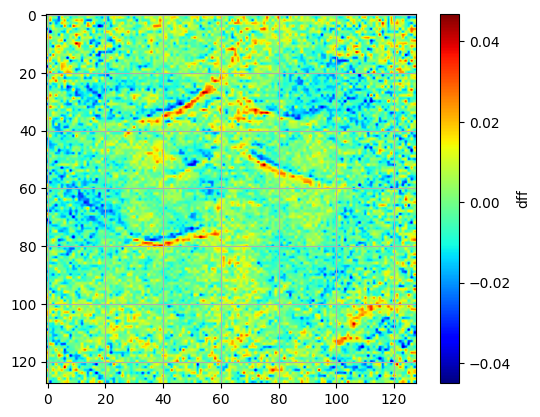

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:45,  2.80it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:42,  2.99it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:40,  3.12it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:38,  3.25it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:38,  3.20it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:38,  3.20it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:37,  3.26it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:38,  3.14it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:37,  3.21it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:37,  3.11it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:37,  3.14it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:35,  3.23it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:36,  3.15it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.20it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.25it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:36,  3.09it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:36,  3.04it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:36,  3.03it/s]

 15%|████████████                                                                     | 19/128 [00:06<00:35,  3.07it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:36,  2.97it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:35,  3.02it/s]

 17%|█████████████▉                                                                   | 22/128 [00:07<00:34,  3.11it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:35,  3.00it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:35,  2.90it/s]

 20%|███████████████▊                                                                 | 25/128 [00:08<00:34,  2.99it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:32,  3.11it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:33,  3.02it/s]

 22%|█████████████████▋                                                               | 28/128 [00:09<00:31,  3.16it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:30,  3.30it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:30,  3.24it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:29,  3.34it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:30,  3.16it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:31,  3.06it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:30,  3.10it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:11<00:29,  3.18it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:28,  3.23it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:28,  3.18it/s]

 30%|████████████████████████                                                         | 38/128 [00:12<00:27,  3.24it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:29,  2.99it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:30,  2.86it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:13<00:28,  3.03it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:27,  3.14it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:25,  3.28it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:14<00:24,  3.44it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:24,  3.38it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:24,  3.34it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:25,  3.17it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:25,  3.12it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:25,  3.06it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:25,  3.09it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:16<00:23,  3.25it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:22,  3.39it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:22,  3.31it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:17<00:22,  3.31it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:22,  3.27it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:24,  2.90it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:18<00:24,  2.92it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:22,  3.09it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:22,  3.11it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:19<00:22,  3.03it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:19<00:21,  3.12it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.16it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:20<00:20,  3.14it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:20<00:20,  3.10it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:20,  3.13it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:21<00:19,  3.22it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:21<00:18,  3.24it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:18,  3.18it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:18,  3.23it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:22<00:18,  3.22it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:18,  3.14it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:23<00:19,  2.83it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:23<00:19,  2.84it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:18,  2.91it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:24<00:18,  2.94it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:24<00:17,  3.00it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:24<00:16,  3.07it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:15,  3.19it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:25<00:15,  3.10it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:25<00:16,  2.97it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:14,  3.16it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:26<00:13,  3.31it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:26<00:13,  3.26it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:13,  3.30it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:27<00:13,  3.21it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:27<00:13,  3.21it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:12,  3.22it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:28<00:12,  3.08it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:28<00:11,  3.26it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:28<00:11,  3.42it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:11,  3.33it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:29<00:11,  3.17it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:29<00:11,  3.16it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:10,  3.25it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:30<00:10,  3.22it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:30<00:10,  3.04it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.18it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:31<00:09,  3.19it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:31<00:09,  3.10it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:08,  3.13it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:32<00:08,  3.16it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:32<00:08,  3.23it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:32<00:07,  3.28it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:33<00:07,  3.22it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:33<00:06,  3.29it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:33<00:06,  3.37it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.33it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:34<00:05,  3.37it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:34<00:05,  3.35it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.28it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:35<00:05,  3.25it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:35<00:05,  2.96it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:35<00:04,  3.03it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:36<00:04,  3.12it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:36<00:04,  3.07it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:36<00:03,  3.21it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:37<00:03,  3.01it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:37<00:03,  3.07it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:37<00:02,  3.09it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:38<00:02,  2.98it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:38<00:02,  3.03it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:38<00:01,  3.11it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:39<00:01,  3.10it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:39<00:01,  3.09it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:39<00:00,  3.20it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:40<00:00,  3.22it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:40<00:00,  3.26it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.34it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.15it/s]

frame number 200 plotted


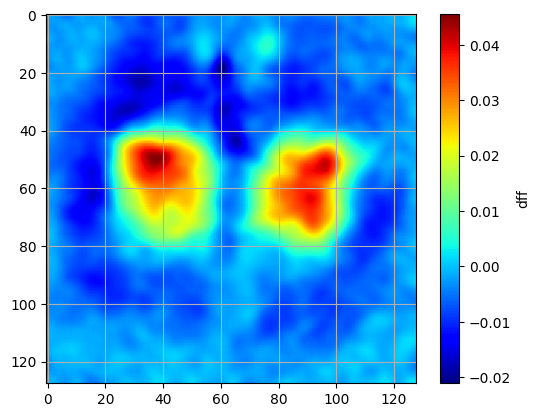

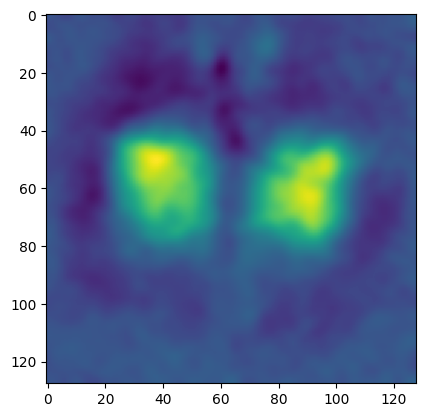

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 14


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 28
fail = 18
total trials = 46


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 26
fail = 14
total trials = 40


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 5
fail = 9
total trials = 14


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34562 [00:00<?, ?it/s]

  7%|█████▏                                                                    | 2406/34562 [00:00<00:01, 23953.00it/s]

 14%|██████████▎                                                               | 4802/34562 [00:00<00:01, 22547.92it/s]

 21%|███████████████▌                                                          | 7254/34562 [00:00<00:01, 23318.62it/s]

 28%|████████████████████▋                                                     | 9691/34562 [00:00<00:01, 23635.90it/s]

 35%|█████████████████████████▊                                               | 12229/34562 [00:00<00:00, 24171.10it/s]

 42%|██████████████████████████████▉                                          | 14650/34562 [00:00<00:00, 23946.01it/s]

 50%|████████████████████████████████████▊                                    | 17437/34562 [00:00<00:00, 25130.33it/s]

 58%|██████████████████████████████████████████▏                              | 19953/34562 [00:00<00:00, 21729.26it/s]

 65%|███████████████████████████████████████████████▍                         | 22449/34562 [00:00<00:00, 22571.34it/s]

 73%|████████████████████████████████████████████████████▉                    | 25075/34562 [00:01<00:00, 23557.09it/s]

 80%|██████████████████████████████████████████████████████████▎              | 27580/34562 [00:01<00:00, 23921.28it/s]

 87%|███████████████████████████████████████████████████████████████▍         | 30009/34562 [00:01<00:00, 23754.26it/s]

 94%|████████████████████████████████████████████████████████████████████▋    | 32509/34562 [00:01<00:00, 24049.68it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34562/34562 [00:01<00:00, 23759.23it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25008.52it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 22230.90it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")